In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from pathlib import Path
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import nibabel as nib
import mne
from scipy.stats import linregress

import mni_utils as uti
from mni_plots import plot_corr, plot_sc_fit, plot_stages_diff

### Paths and names

In [56]:
data_path = Path("F:\\iEEG_neural_dynamics\\MNIOpen")
res_dir = "Results_SC"
res_tau_dir = "Results_acf_fit_exp"
res_path = data_path.joinpath(res_dir)
res_tau_path = data_path.joinpath(res_tau_dir)

## 1) Load SC parameters, timescales and parcellation

Parcellation:

In [4]:
subjects_dir = str(mne.datasets.sample.data_path()) + "/subjects"
parc_map_name = "HCPMMP1"
annot_file = annot_file = (
    subjects_dir + "/fsaverage/label/lh." + parc_map_name + ".annot"
)
parc_labels, ctab, parc_names = nib.freesurfer.read_annot(annot_file)

SC results and parameters:

In [5]:
# Dataframe with data on all channles pairs
df_sc_stages = {
    stage: pd.read_csv(res_path.joinpath(f"SC_{stage}.csv"), index_col=0)
    for stage in ["W", "N3", "R"]
}

# Dataframe with the total binned data
df_sc_bins_stages = {
    stage: pd.read_csv(res_path.joinpath(f"SC_{stage}_bins.csv"), index_col=0)
    for stage in ["W", "N3", "R"]
}

# Dataframe with the fit parameters of df_sc_bins_stages
df_sc_params_stages = {
    stage: pd.read_csv(res_path.joinpath(f"SC_{stage}_fit.csv"), index_col=0)
    for stage in ["W", "N3", "R"]
}

# Dataframe with the fit parameters on each MNI region
df_sc_params_mni_stages = {
    stage: pd.read_csv(res_path.joinpath(f"SC_{stage}_fit_mni_regs.csv"), index_col=0)
    for stage in ["W", "N3", "R"]
}
# Fitted on binned distance:
df_sc_params_mni_stages_bins = {
    stage: pd.read_csv(
        res_path.joinpath(f"SC_{stage}_fit_mni_regs_bins.csv"), index_col=0
    )
    for stage in ["W", "N3", "R"]
}

# Dataframe with the fit parameters on each MMP region
df_sc_params_mmp_stages = {
    stage: pd.read_csv(res_path.joinpath(f"SC_{stage}_fit_mmp_regs.csv"), index_col=0)
    for stage in ["W", "N3", "R"]
}
# Fitted on binned distance:
df_sc_params_mmp_stages_bins = {
    stage: pd.read_csv(
        res_path.joinpath(f"SC_{stage}_fit_mmp_regs_bins.csv"), index_col=0
    )
    for stage in ["W", "N3", "R"]
}

## 2) Plot SC parameters globally and for each region

Plot of fits:

{'W': array([11.22826962,  0.42215823,  0.05434913]), 'N3': array([10.27736862,  0.34869673,  0.07936772]), 'R': array([10.21590357,  0.33860094,  0.05660107])}


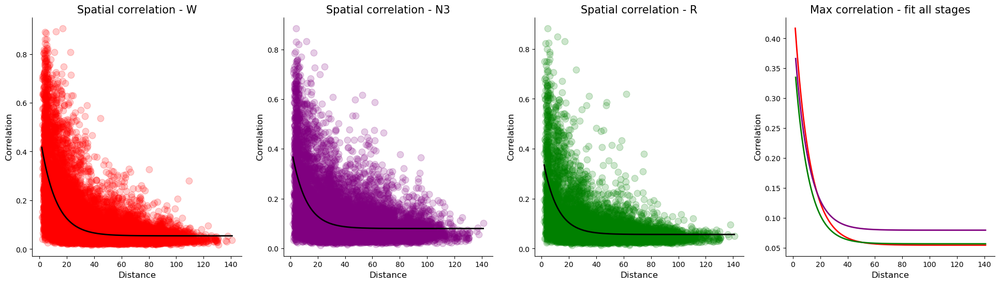

In [6]:
colors_stage = {"W": "r", "N3": "purple", "R": "g"}
params_stages = {
    stage: par.to_numpy().squeeze() for stage, par in df_sc_params_stages.items()
}
print(params_stages)
fig, axs = plot_sc_fit(df_sc_stages, params_stages, colors_stage)
plt.show()

Plot fit for each region to check goodness:

Middle temporal gyrus


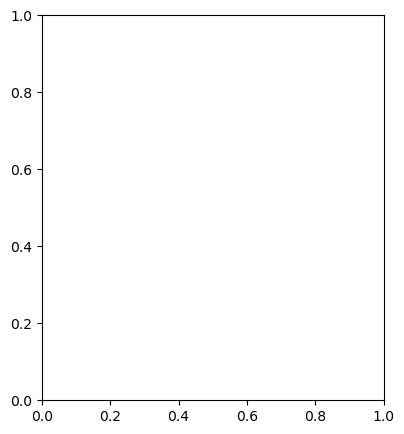

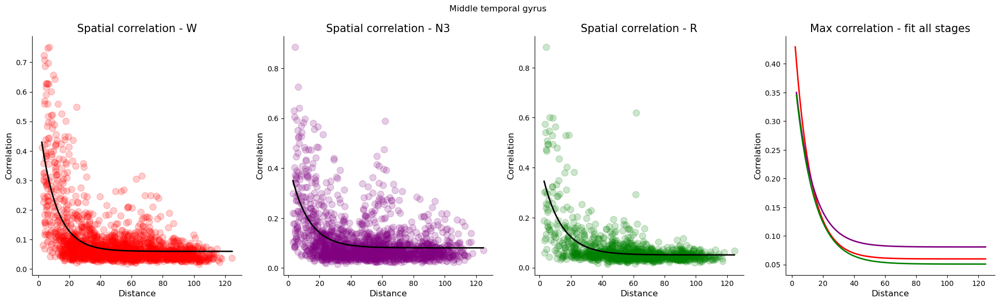

Medial frontal cortex


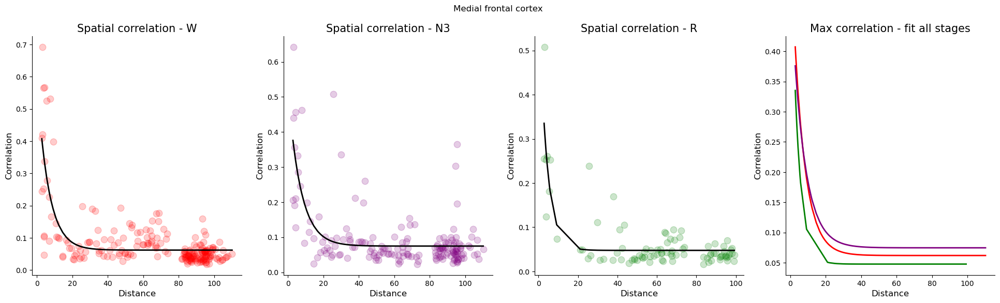

Planum temporale


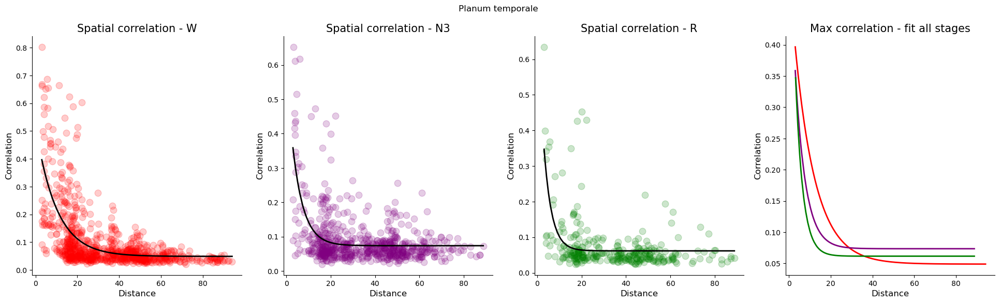

Middle cingulate


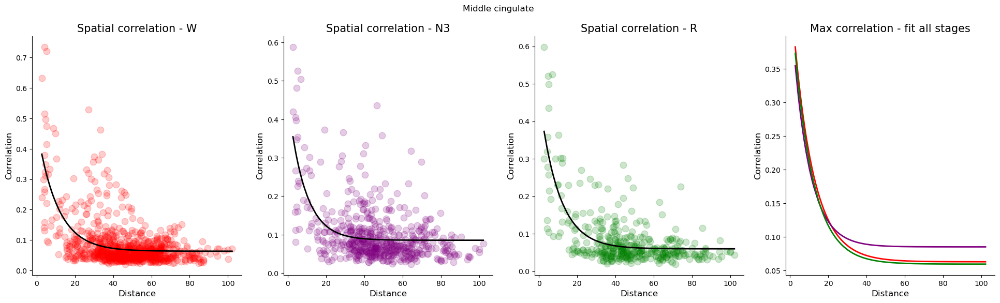

Precentral gyrus


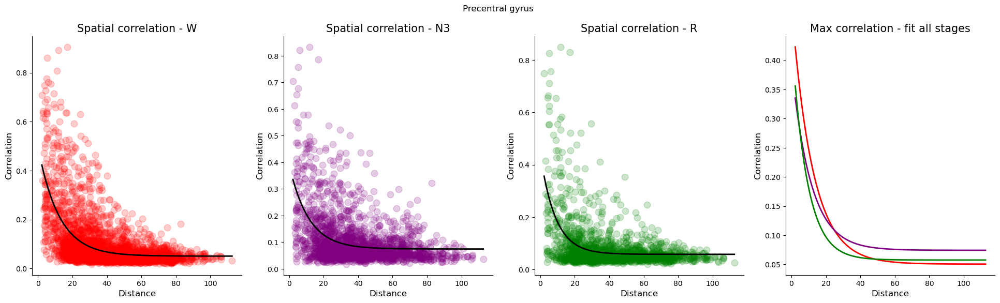

Supplementary motor cortex


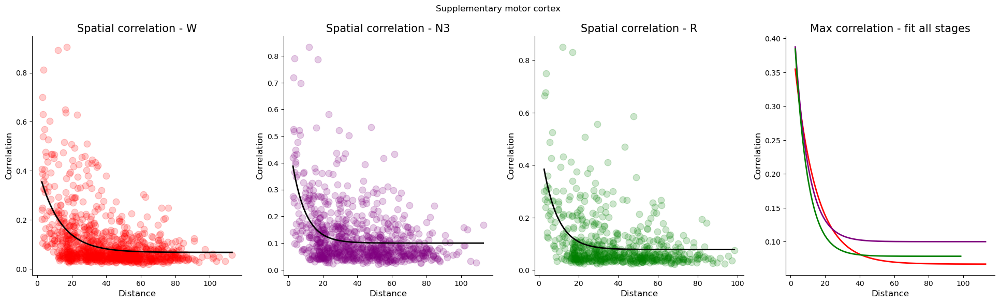

Anterior insula


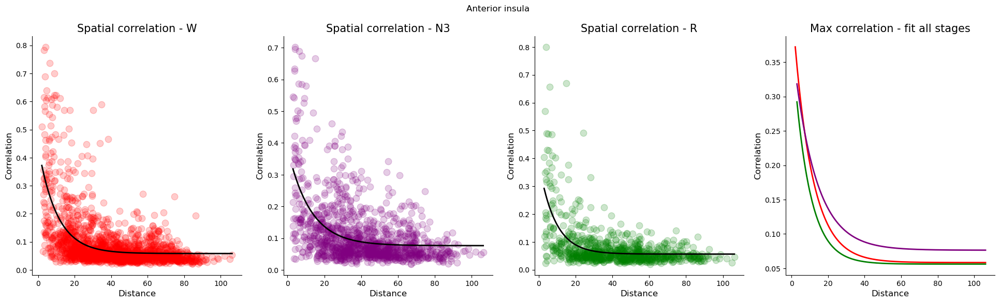

Temporal pole and planum polare


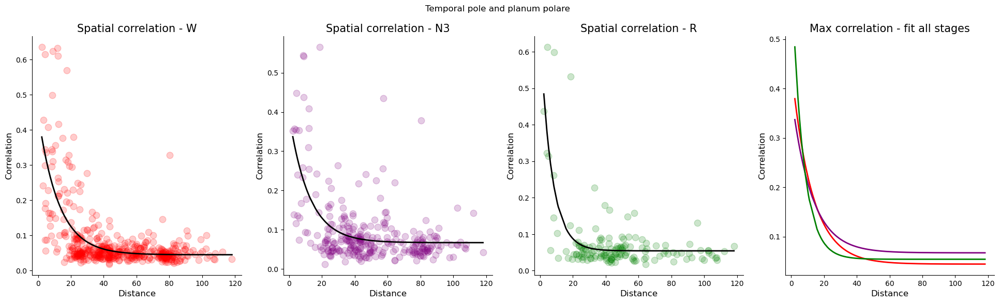

Hippocampus


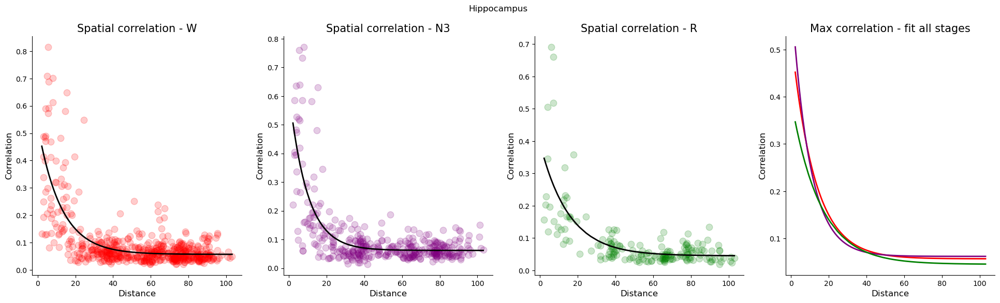

Central operculum


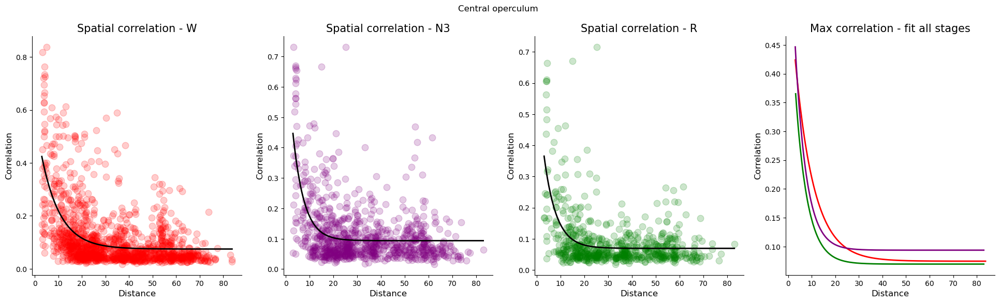

Transverse temporal gyrus


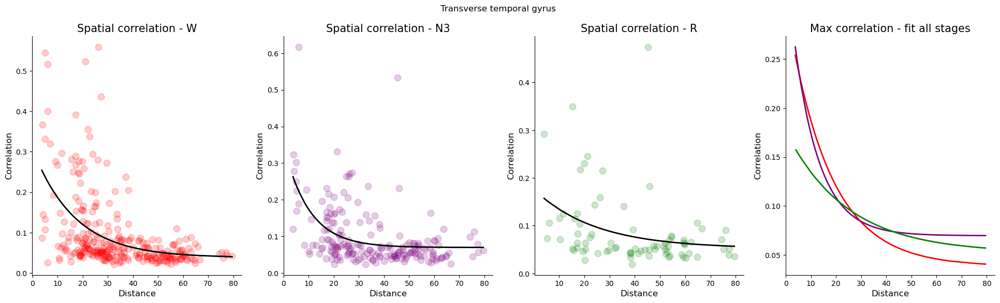

Lingual gyrus and occipital fusiform gyrus


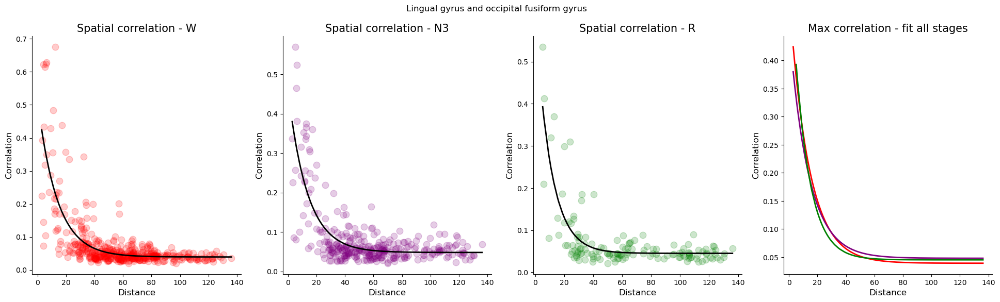

Fusiform and parahippocampal gyri


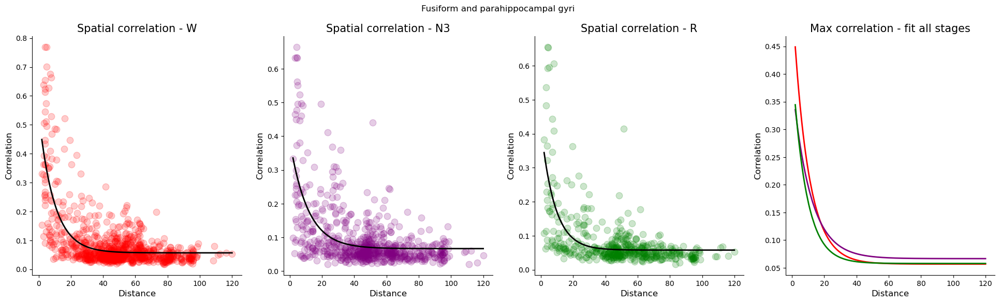

Inferior temporal gyrus


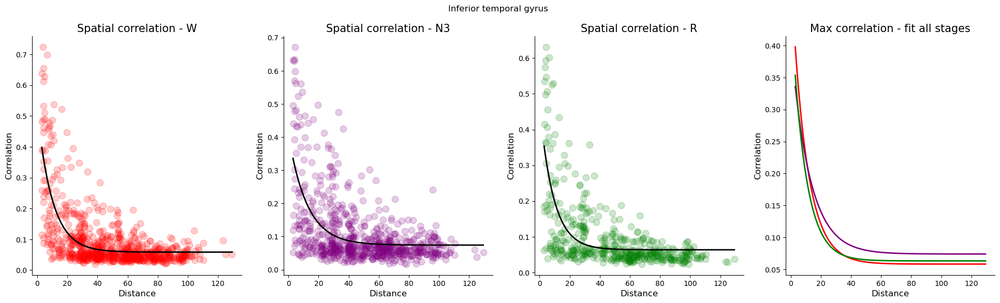

Postcentral gyrus (including medial segment)


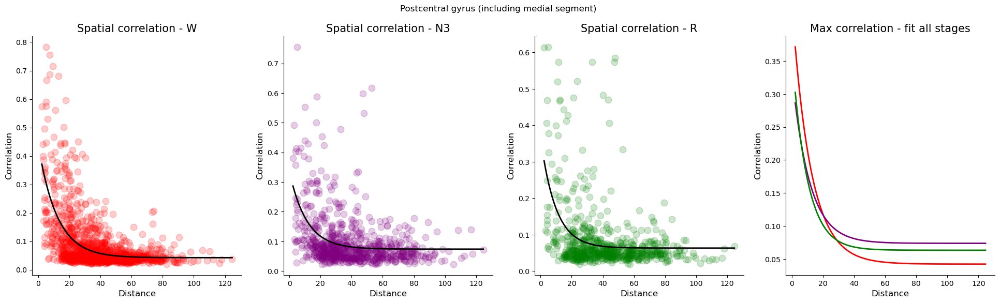

Precuneus


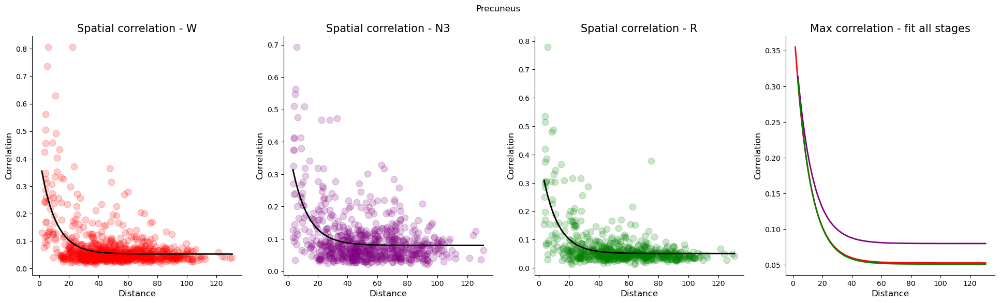

Angular gyrus


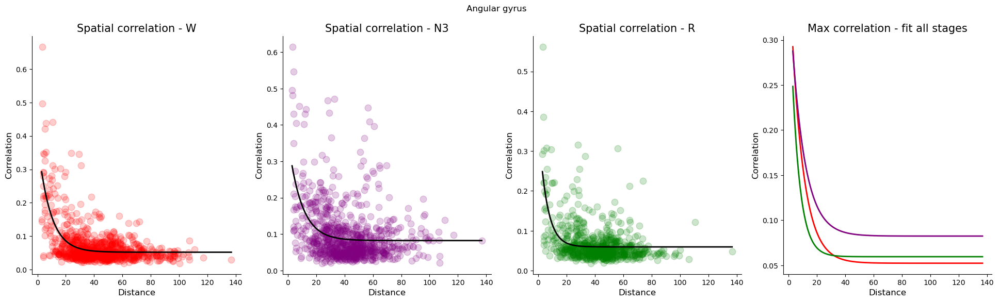

Opercular part of inferior frontal gyrus


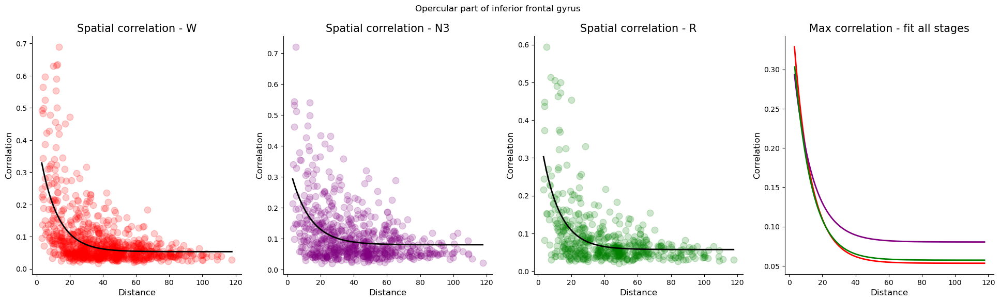

Parietal operculum


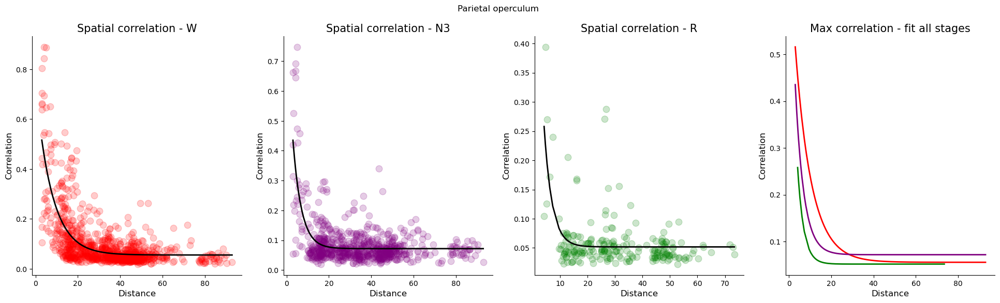

Frontal operculum


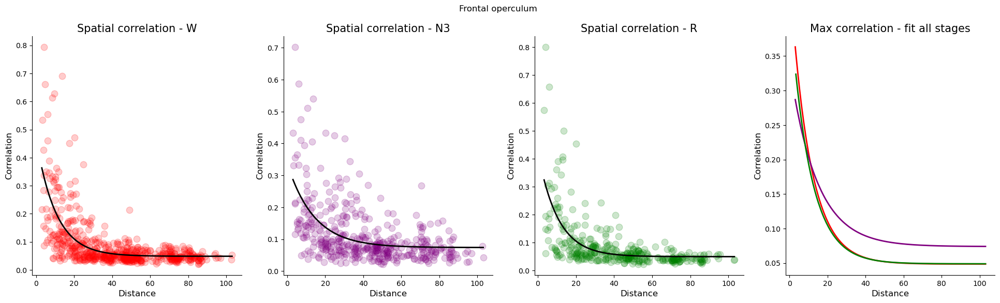

Triangular part of inferior frontal gyrus


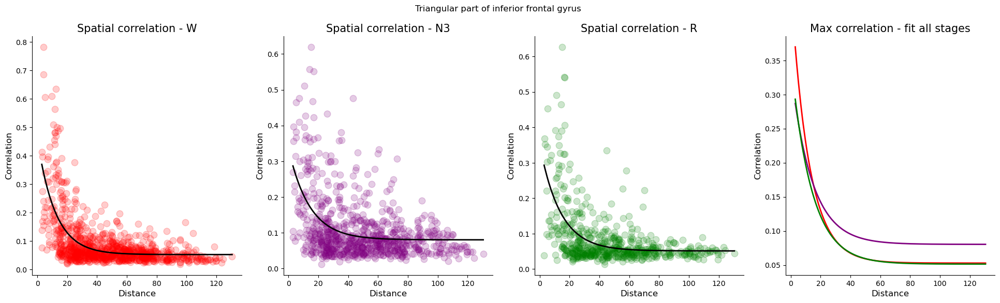

Middle frontal gyrus


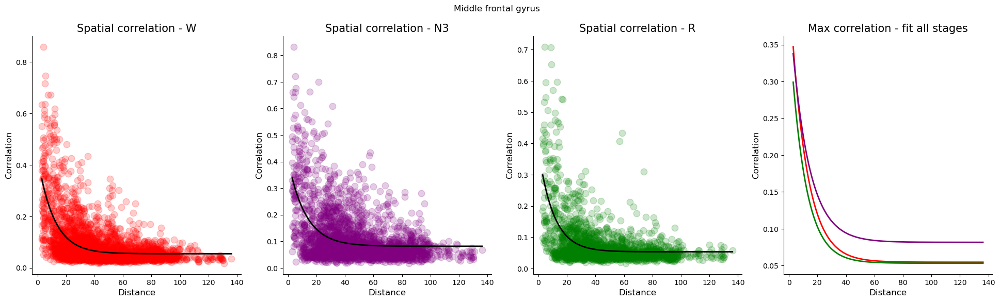

Anterior cingulate


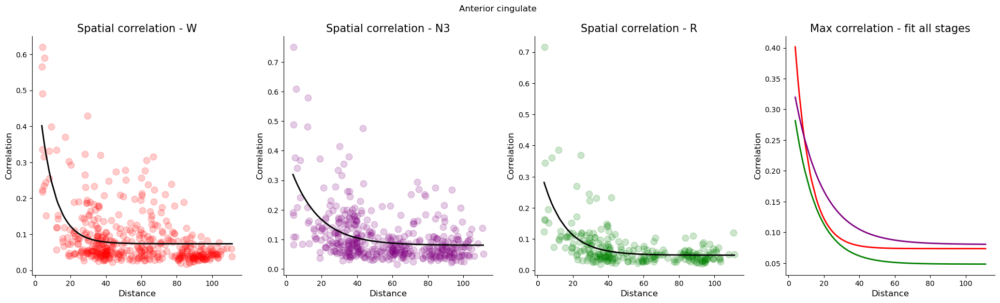

Superior temporal gyrus


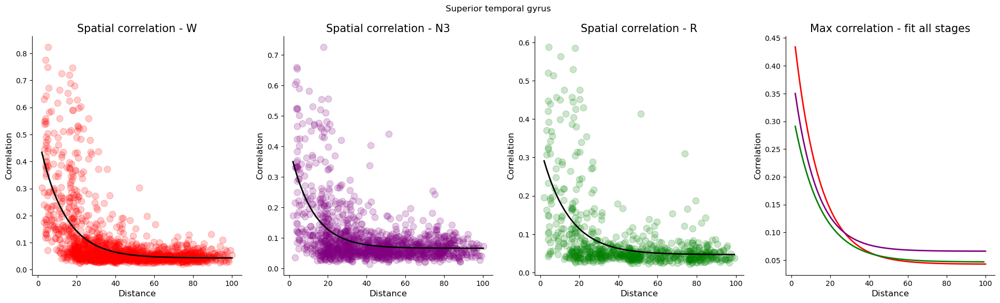

Posterior insula


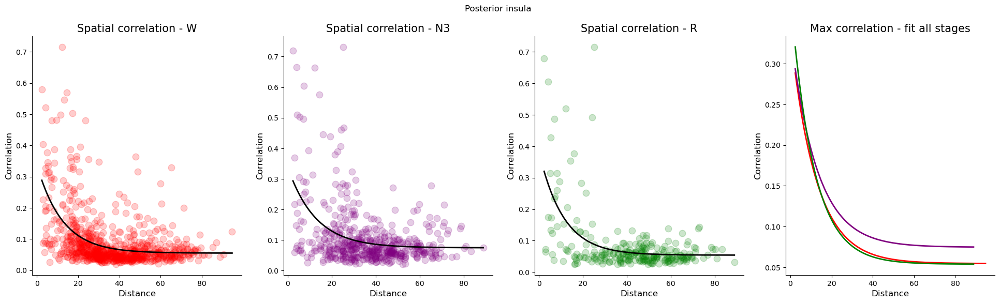

Medial segment of precentral gyrus


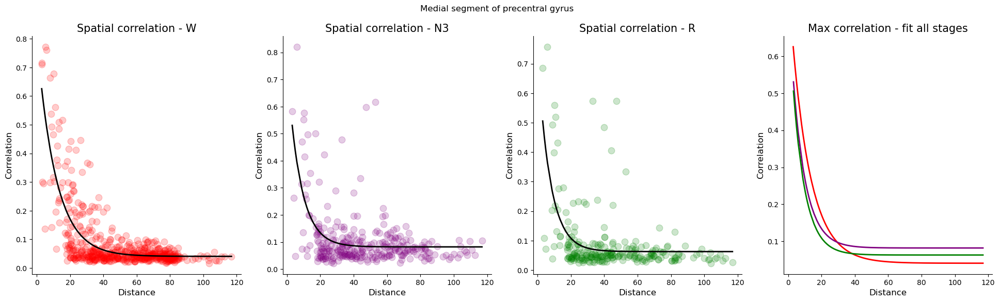

Medial segment of superior frontal gyrus


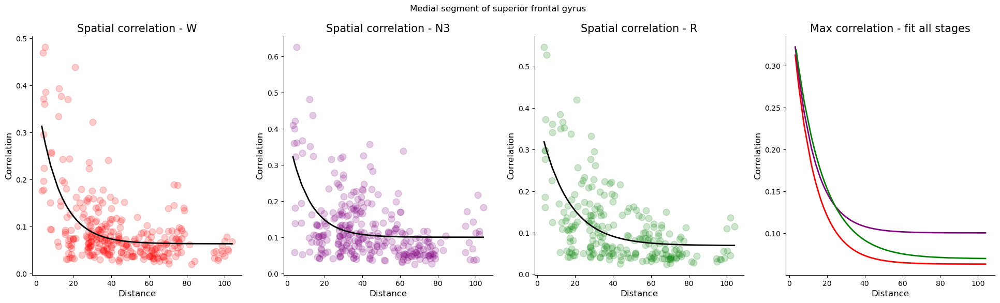

Superior frontal gyrus and frontal pole


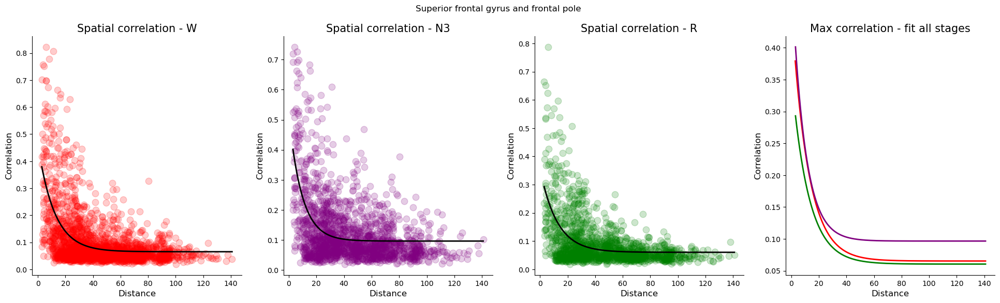

Superior parietal lobule


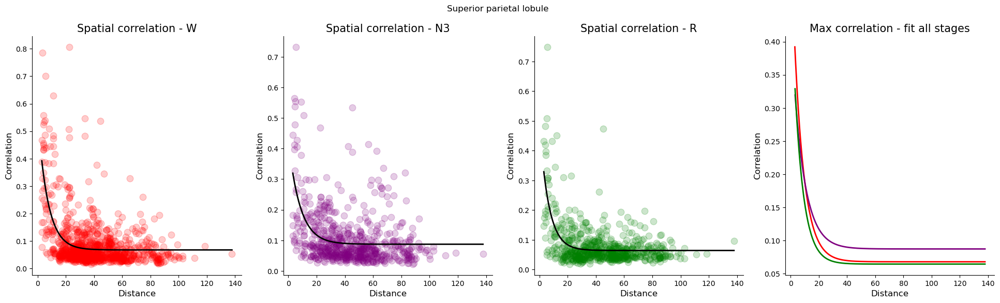

Posterior cingulate


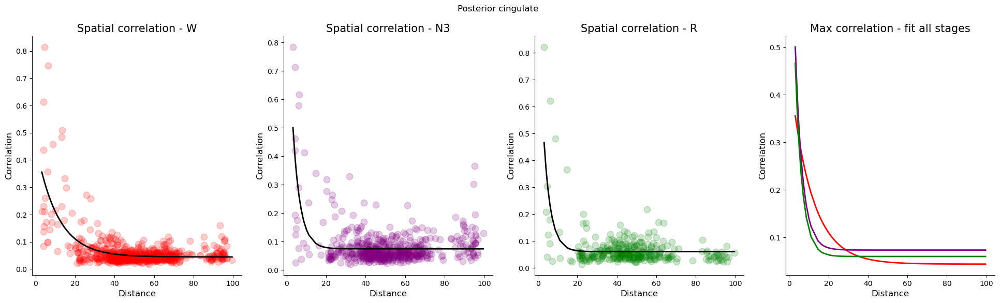

Supramarginal gyrus


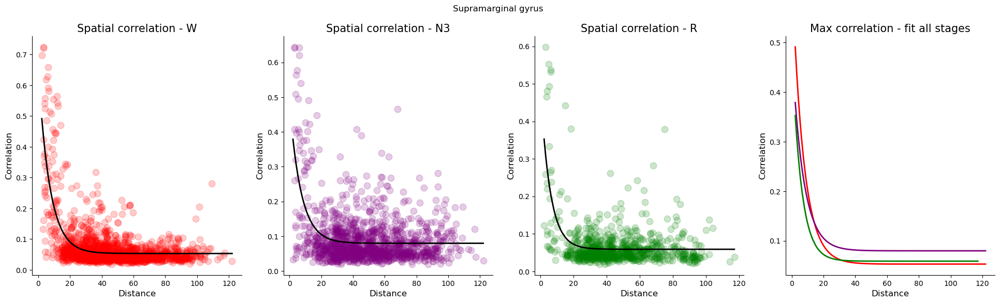

Gyrus rectus and orbital gyri


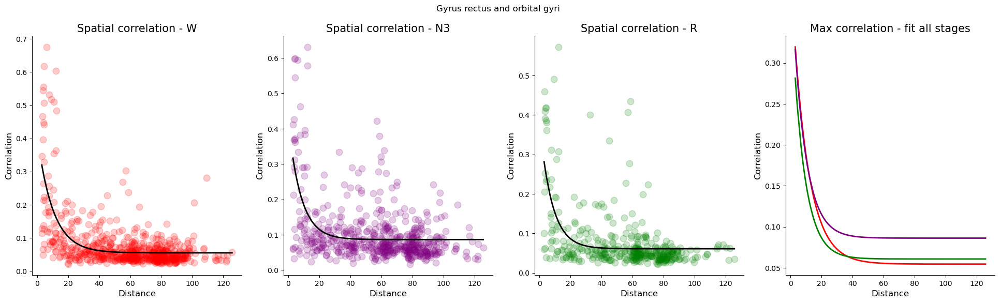

Amygdala


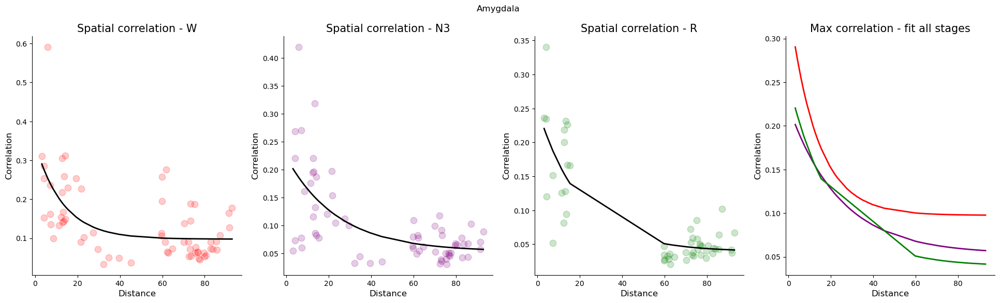

Inferior ocipital gyrus and occipital pole


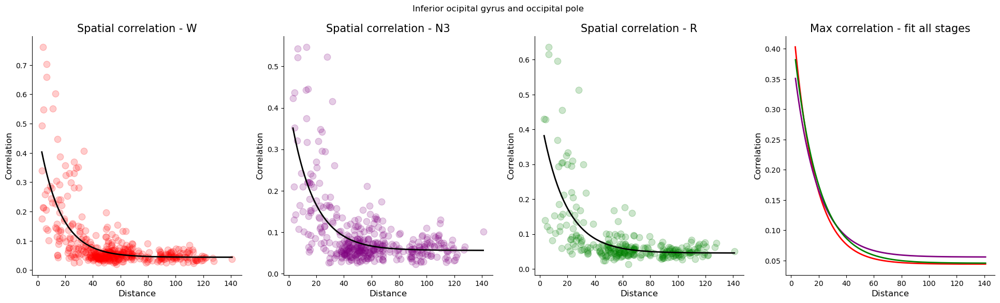

Calcarine cortex


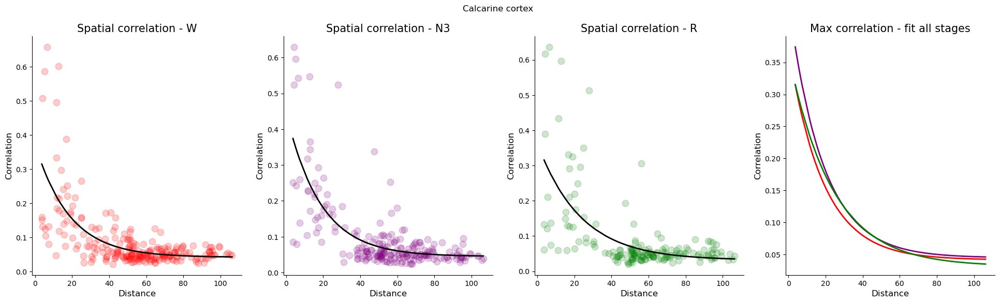

Superior and middle occipital gyri


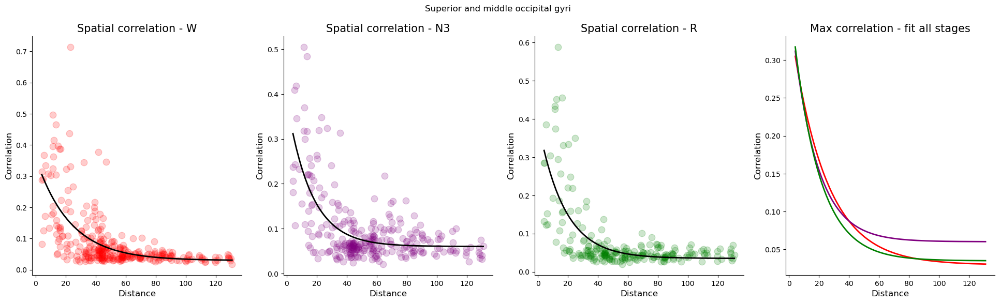

Cuneus


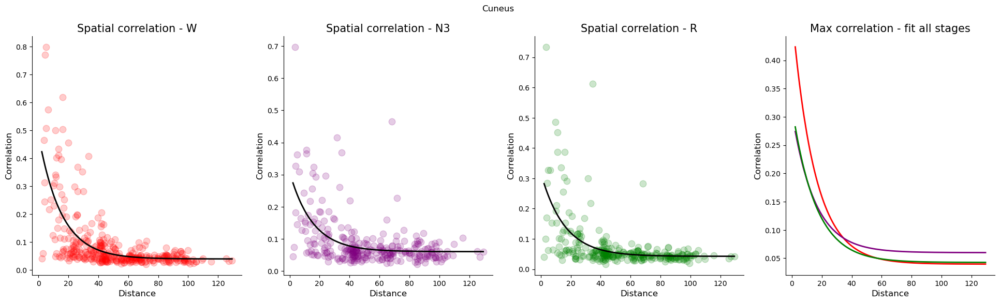

Orbital part of inferior frontal gyrus


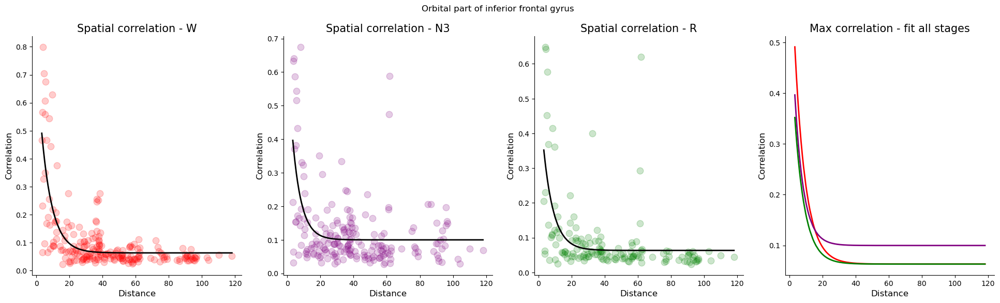

In [47]:
colors_stage = {"W": "r", "N3": "purple", "R": "g"}
params_stages_all = {}
for region in df_sc_params_mni_stages["W"].index:
    print(region)
    params_stages = {
        stage: df_sc_params_mni_stages[stage]
        .loc[region, ["k", "a", "b"]]
        .to_numpy()
        .squeeze()
        for stage in ["W", "N3", "R"]
    }
    params_stages_all[region] = params_stages.copy()
    df_sc_stages_region = {
        stage: df_sc_stages[stage][
            (df_sc_stages[stage]["region_1"] == region)
            | (df_sc_stages[stage]["region_2"] == region)
        ]
        for stage in ["W", "N3", "R"]
    }
    fig, axs = plot_sc_fit(df_sc_stages_region, params_stages, colors_stage)
    fig.suptitle(region)
    plt.show()

Fitting of bins:

Middle temporal gyrus


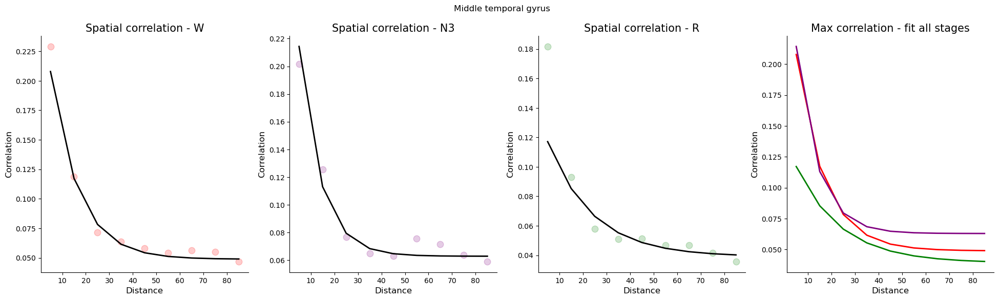

Medial frontal cortex


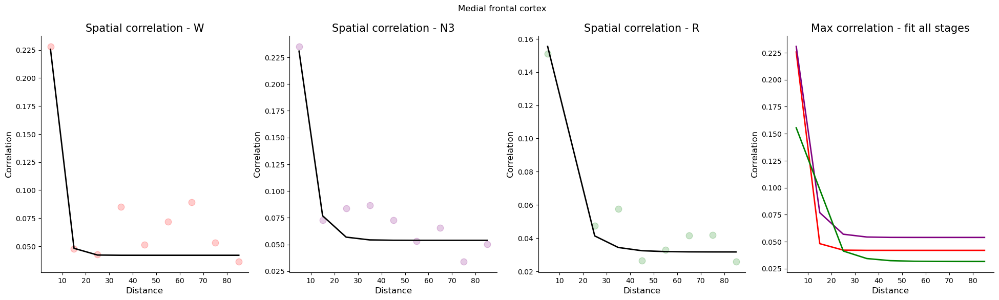

Planum temporale


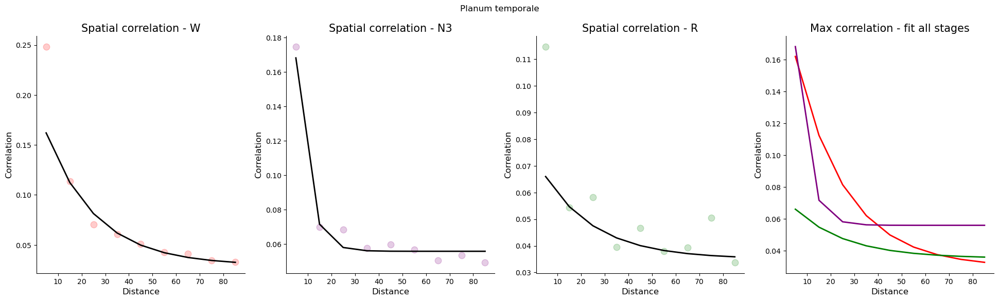

Middle cingulate


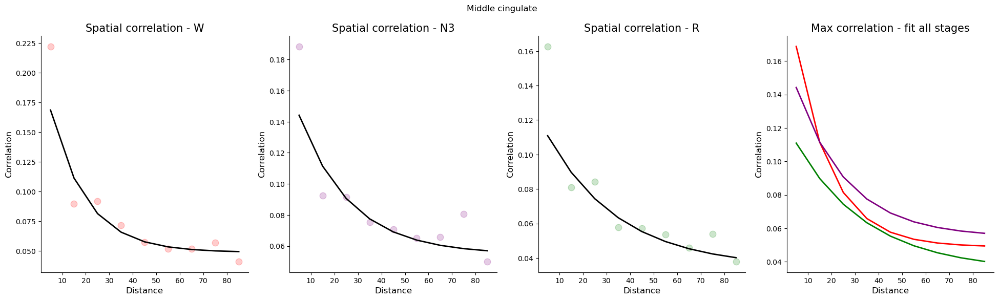

Precentral gyrus


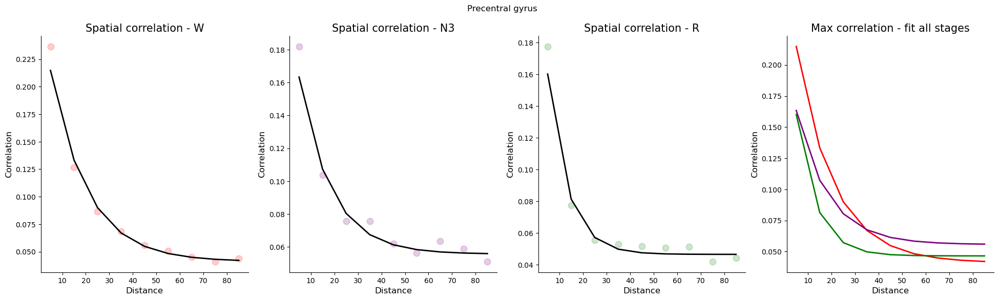

Supplementary motor cortex


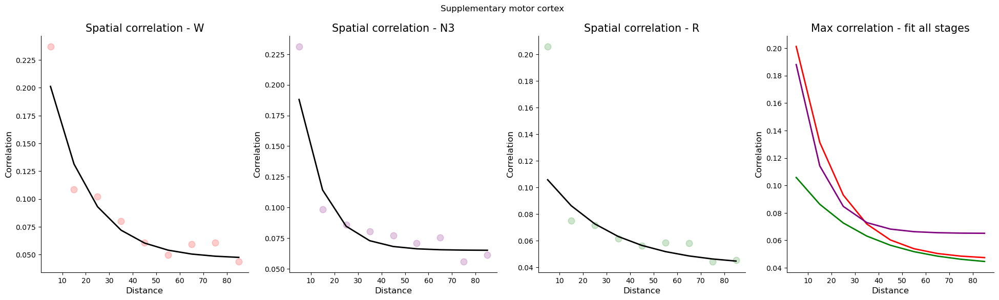

Anterior insula


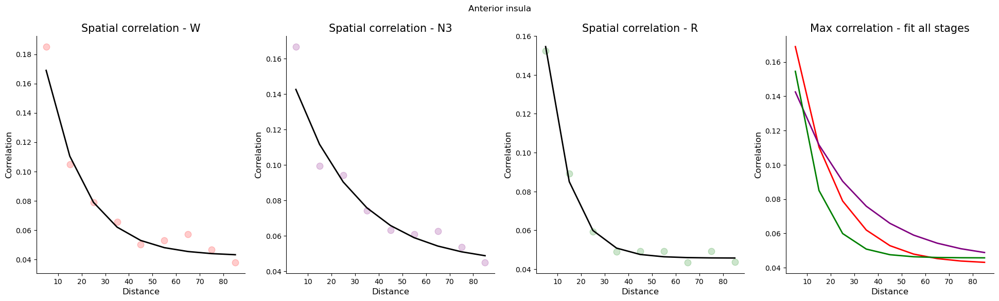

Temporal pole and planum polare


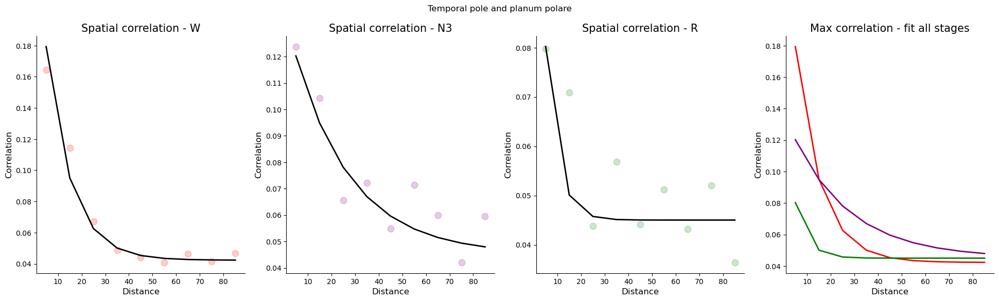

Hippocampus


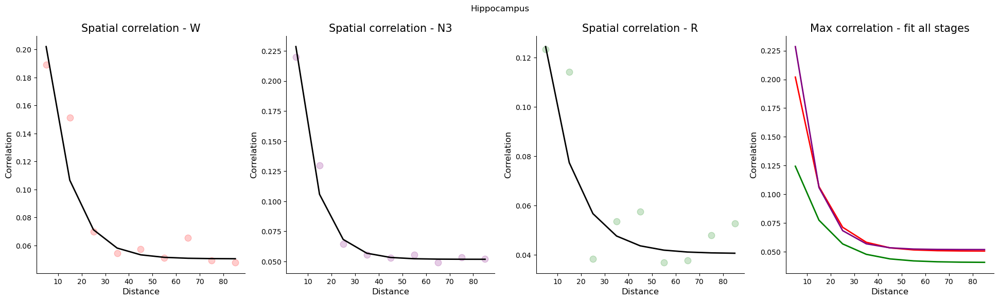

Central operculum


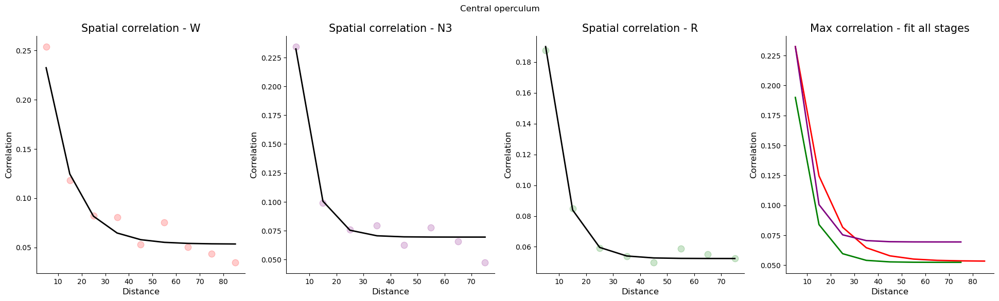

Transverse temporal gyrus


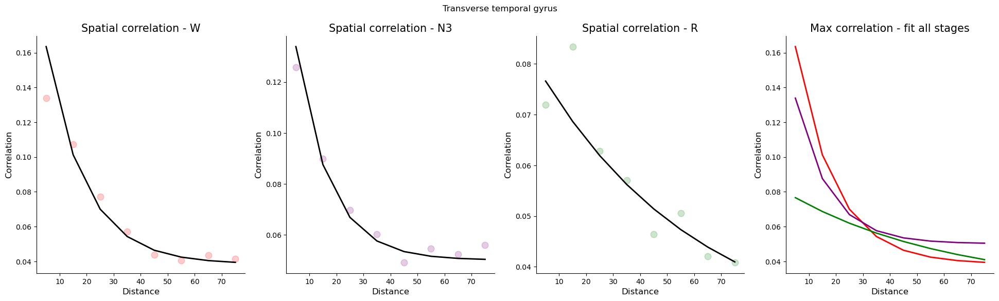

Lingual gyrus and occipital fusiform gyrus


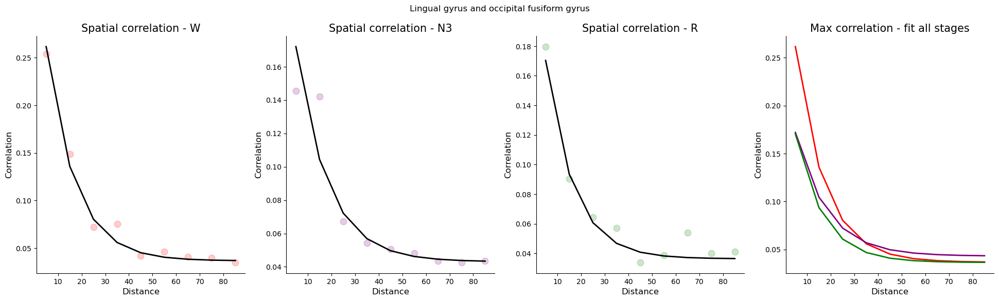

Fusiform and parahippocampal gyri


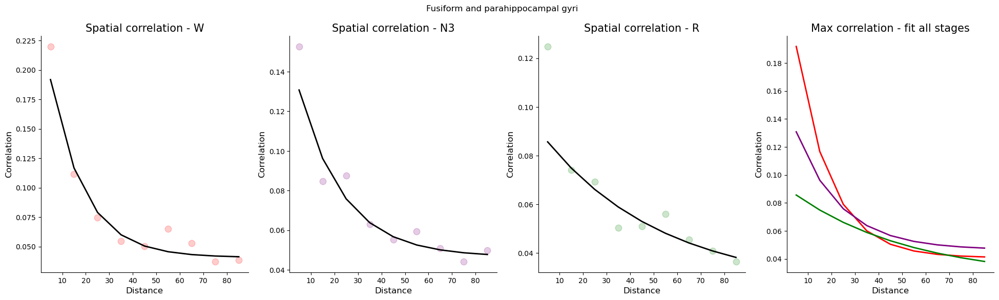

Inferior temporal gyrus


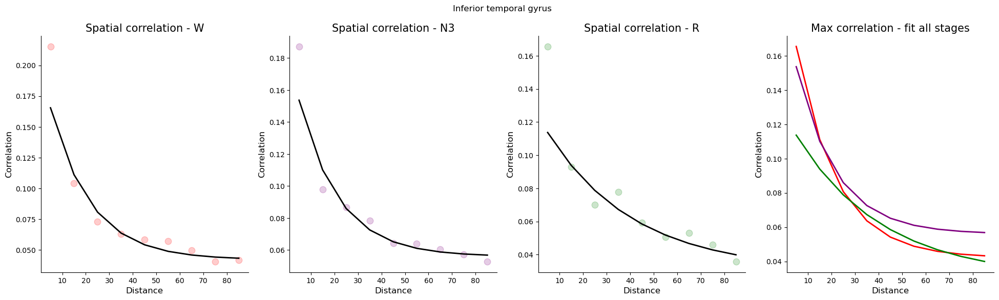

Postcentral gyrus (including medial segment)


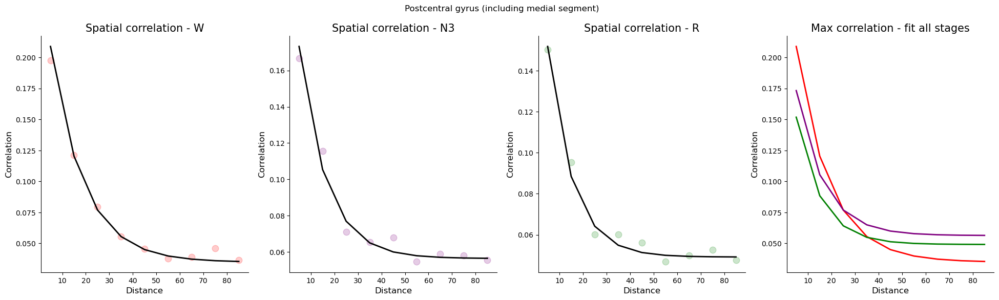

Precuneus


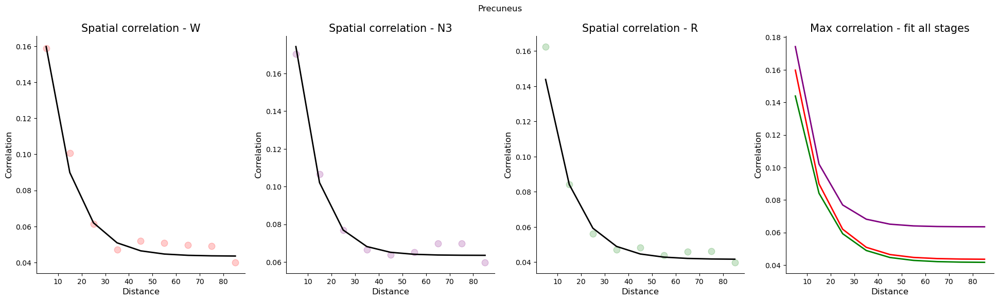

Angular gyrus


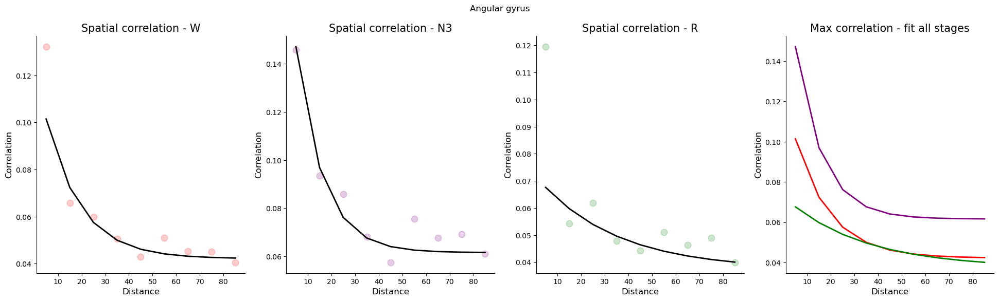

Opercular part of inferior frontal gyrus


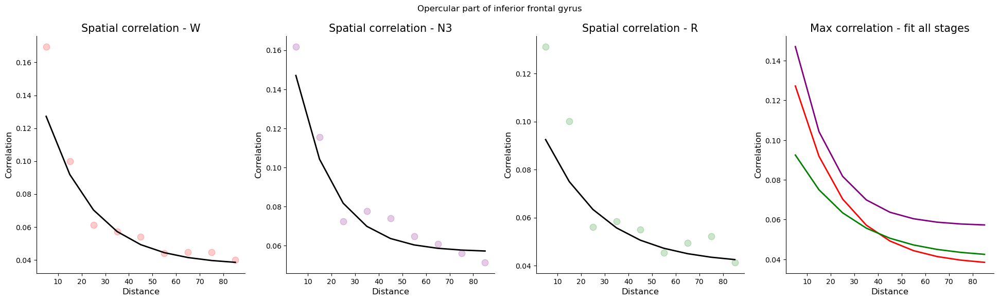

Parietal operculum


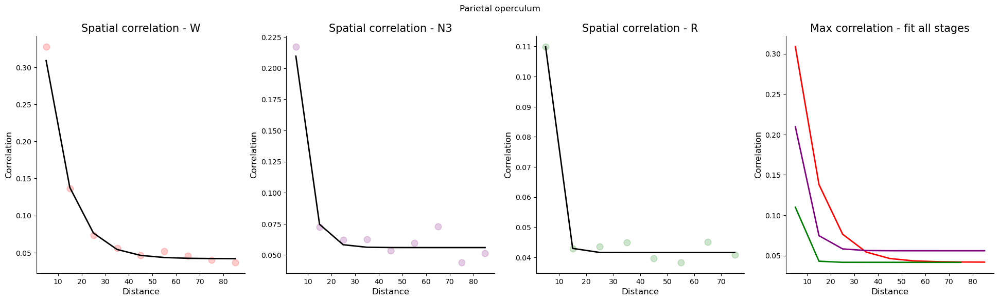

Frontal operculum


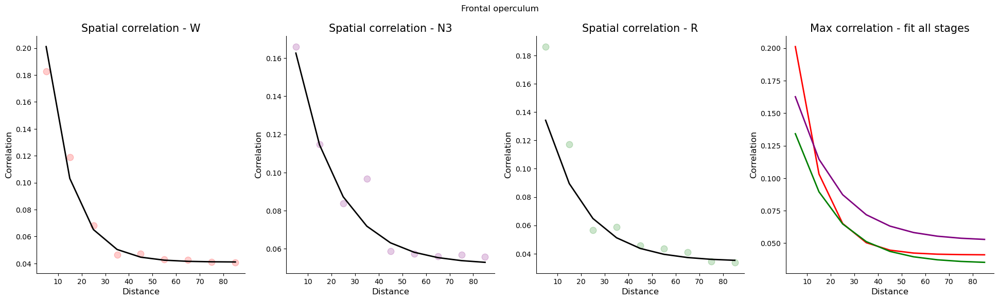

Triangular part of inferior frontal gyrus


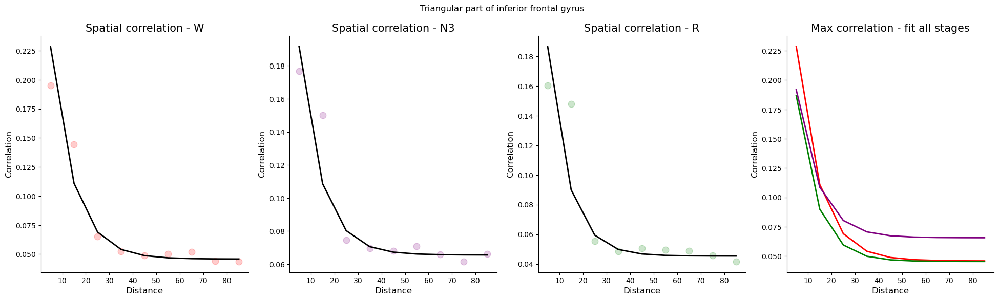

Middle frontal gyrus


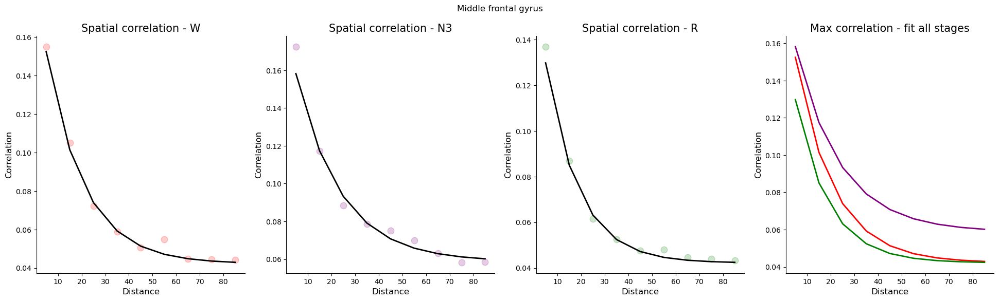

Anterior cingulate


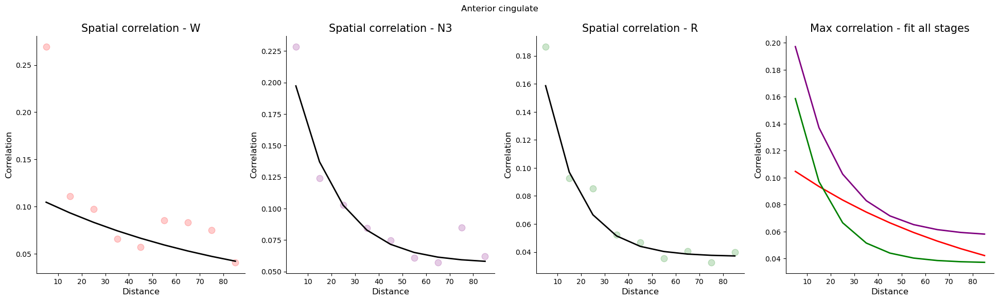

Superior temporal gyrus


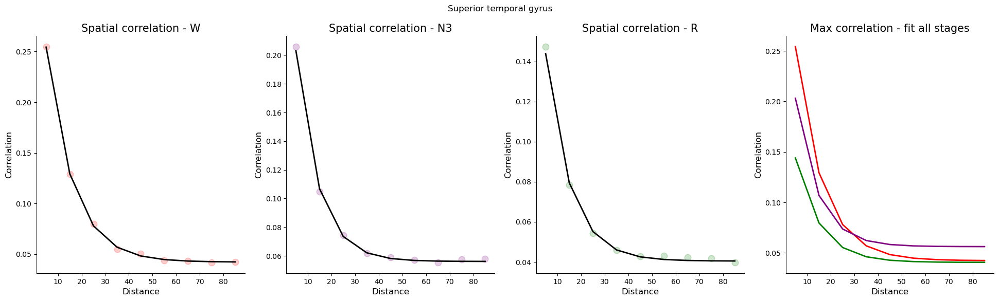

Posterior insula


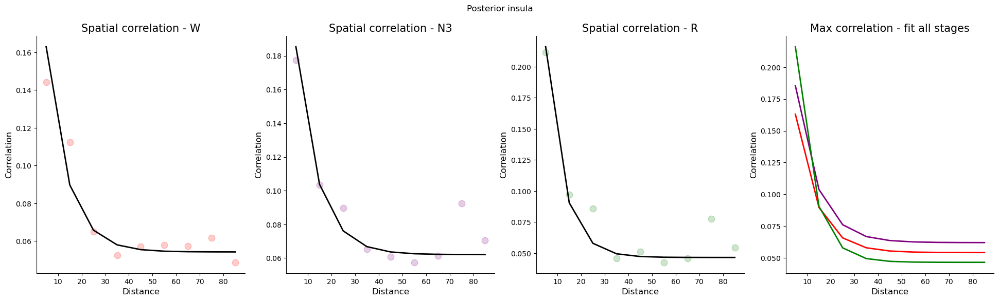

Medial segment of precentral gyrus


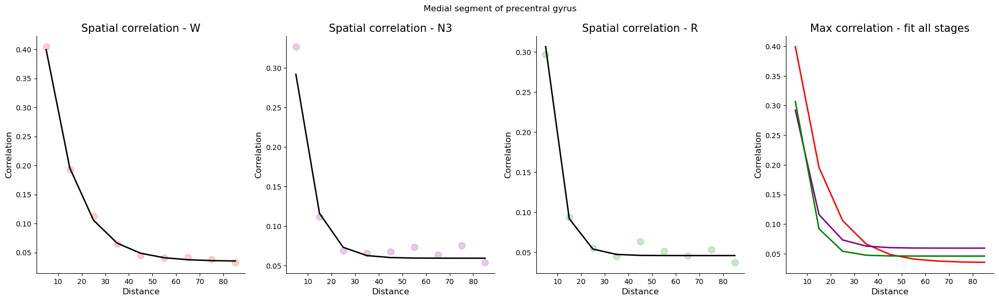

Medial segment of superior frontal gyrus


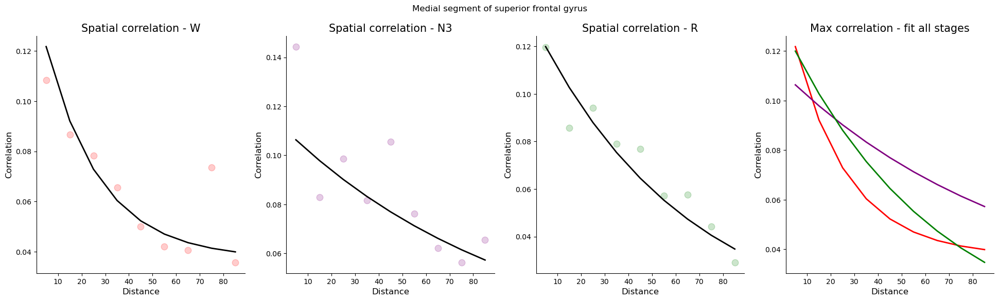

Superior frontal gyrus and frontal pole


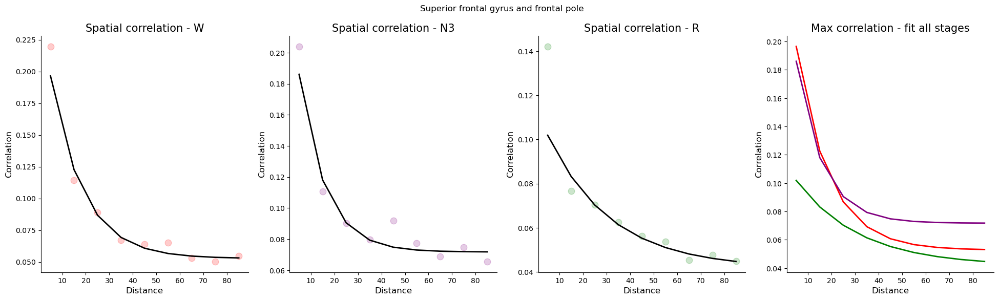

Superior parietal lobule


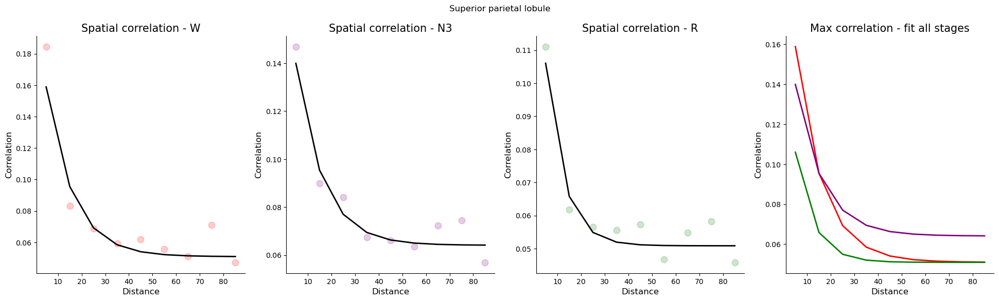

Posterior cingulate


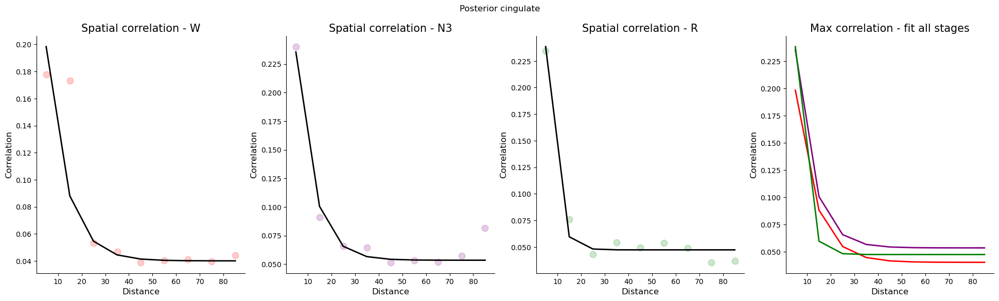

Supramarginal gyrus


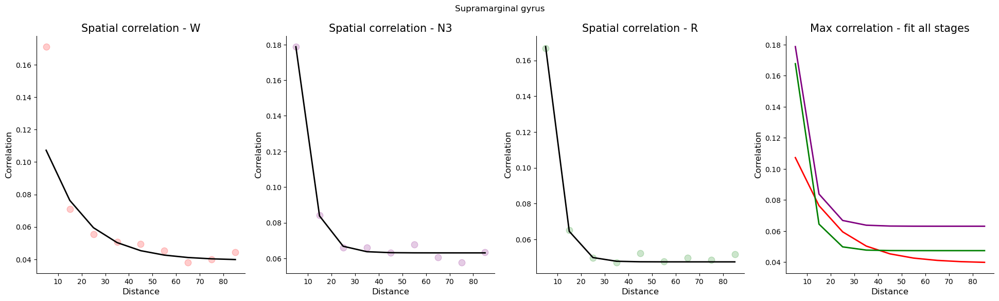

Gyrus rectus and orbital gyri


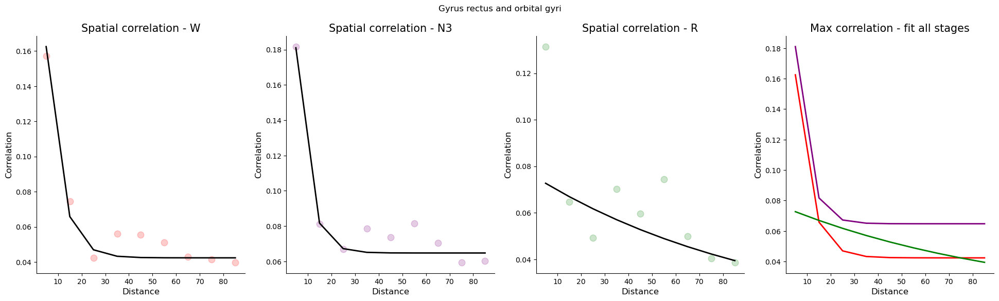

Amygdala


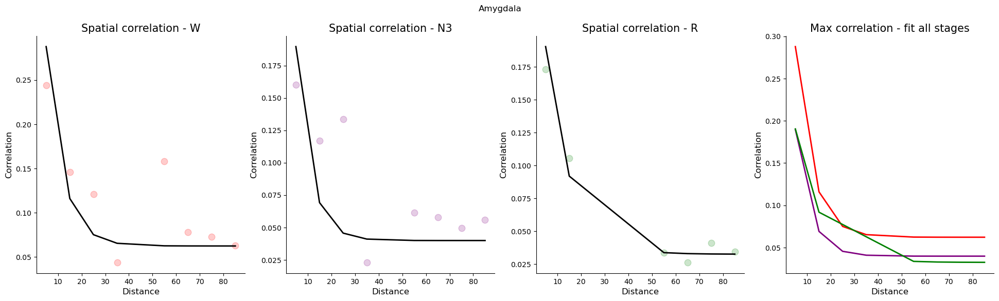

Inferior ocipital gyrus and occipital pole


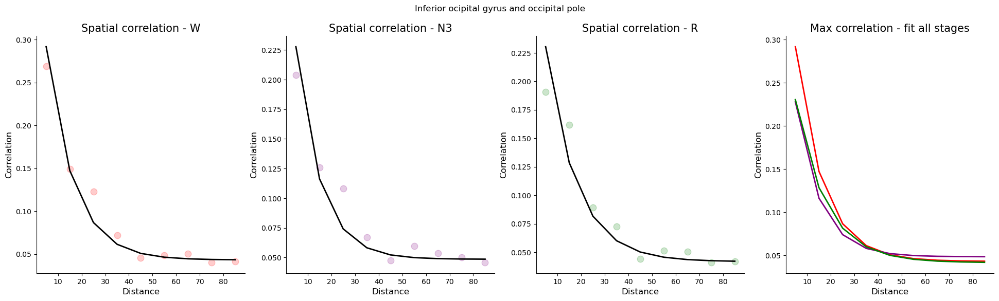

Calcarine cortex


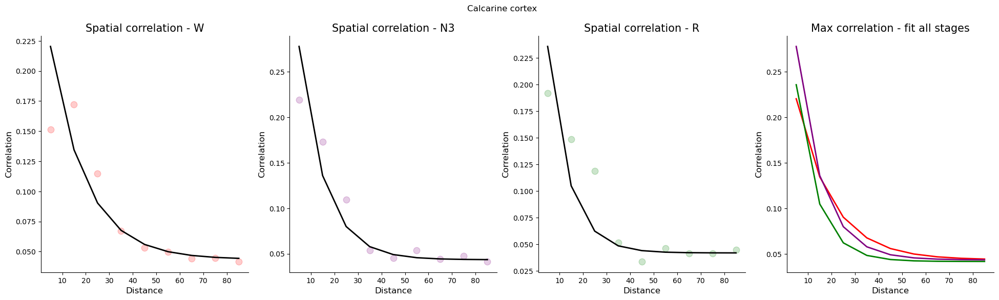

Superior and middle occipital gyri


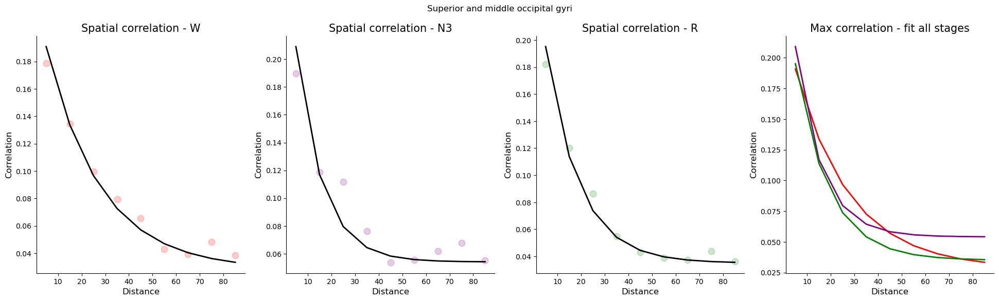

Cuneus


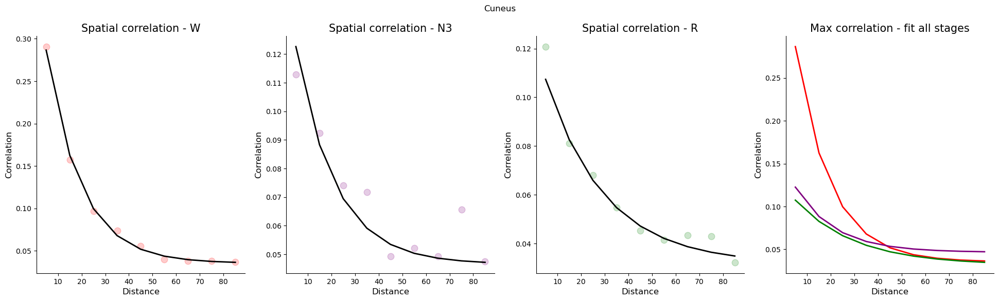

Orbital part of inferior frontal gyrus


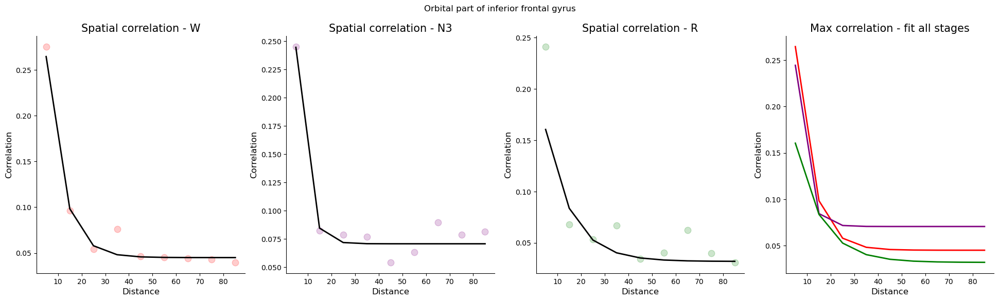

In [28]:
colors_stage = {"W": "r", "N3": "purple", "R": "g"}
params_stages_bins = {}
for region in df_sc_params_mni_stages_bins["W"].index:
    print(region)
    params_stages = {
        stage: df_sc_params_mni_stages_bins[stage]
        .loc[region, ["k", "a", "b"]]
        .to_numpy()
        .squeeze()
        for stage in ["W", "N3", "R"]
    }
    params_stages_bins[region] = params_stages
    df_sc_stages_region = {
        stage: df_sc_stages[stage][
            (df_sc_stages[stage]["region_1"] == region)
            | (df_sc_stages[stage]["region_2"] == region)
        ]
        for stage in ["W", "N3", "R"]
    }
    df_sc_stages_region = {
        stage: uti.compute_sc_bin(df_sc_reg, bins=np.arange(0, 100, 10)).rename(
            columns={"bin": "dist"}
        )
        for stage, df_sc_reg in df_sc_stages_region.items()
    }
    fig, axs = plot_sc_fit(df_sc_stages_region, params_stages, colors_stage)
    fig.suptitle(region)
    plt.show()

Correlate parameters with the two methods:

W
k - rho = 0.07090423426110472, p = 0.6722840452233292
a - rho = 0.3534650433133142, p = 0.029485492030159294
b - rho = 0.3821833514675885, p = 0.017888720998339627


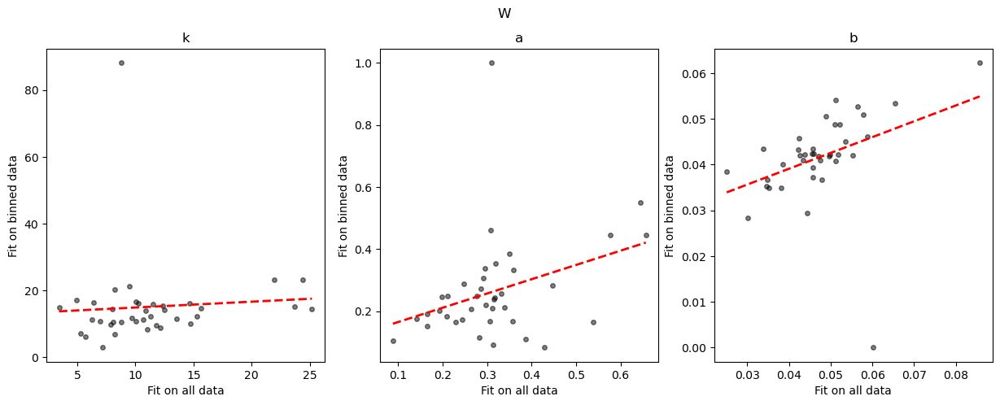

N3
k - rho = 0.4273587908703514, p = 0.007447681919030247
a - rho = 0.42836928937808816, p = 0.0072932347658510545
b - rho = 0.525671579594161, p = 0.000700876268443244


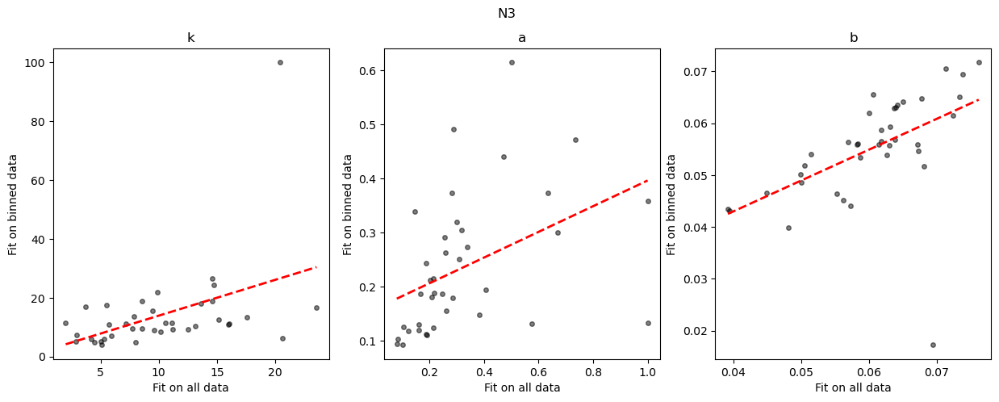

R
k - rho = 0.4324151044538854, p = 0.006702098760373984
a - rho = 0.41688463611031423, p = 0.009221159352377387
b - rho = 0.519856884055764, p = 0.0008225325661719178


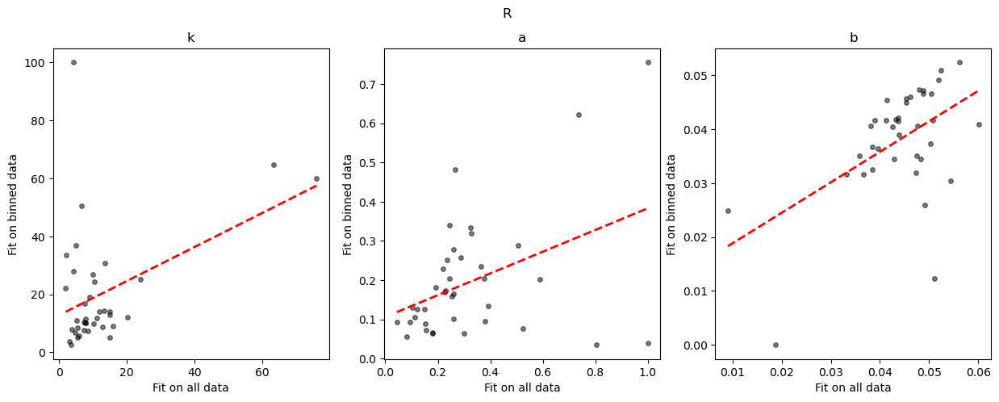

In [29]:
for stage in ["W", "N3", "R"]:
    print(stage)
    plt.figure(figsize=(15, 5))
    for i, name in enumerate(["k", "a", "b"]):
        plt.subplot(1, 3, i + 1)
        params_regions_stage = np.array(
            [params_stages_all[reg][stage] for reg in params_stages_all.keys()]
        ).astype(float)
        params_regions_stage_bins = np.array(
            [params_stages_bins[reg][stage] for reg in params_stages_bins.keys()]
        ).astype(float)
        plt.plot(
            params_regions_stage[:, i],
            params_regions_stage_bins[:, i],
            "ko",
            ms=4,
            alpha=0.5,
        )
        m, q, r, p, _ = linregress(
            params_regions_stage[:, i], params_regions_stage_bins[:, i]
        )
        print(f"{name} - rho = {r}, p = {p}")
        x_plot = np.linspace(
            params_regions_stage[:, i].min(), params_regions_stage[:, i].max(), 100
        )
        plt.plot(x_plot, m * x_plot + q, "r--", lw=2)
        plt.title(f"{name}")
        plt.xlabel("Fit on all data")
        plt.ylabel("Fit on binned data")
        plt.suptitle(stage)
    plt.show()

## Test with power law fit

In [38]:
from scipy import optimize


def _pow_law(x, k, a, b, c):
    return a * (x - c) ** (-k) + b


params_stages_pl = {}
for stage in ["W", "N3", "R"]:
    x = df_sc_stages[stage]["dist"].to_numpy(dtype=float)
    y = df_sc_stages[stage]["corr_max"].to_numpy(dtype=float)
    # y_err = df_sc_stages[stage]["corr_max_sem"].to_numpy(dtype=float)
    if len(y) < 2:
        popt = np.array([np.nan, np.nan, np.nan])
    popt, pcov = optimize.curve_fit(
        _pow_law,
        x,
        y,
        # sigma=y_err,
        bounds=((0, 0, 0, -np.inf), (np.inf, np.inf, 1, 0)),
    )
    params_stages_pl[stage] = popt

RuntimeError: Optimal parameters not found: The maximum number of function evaluations is exceeded.

{'W': array([6.66525779e-01, 9.09114432e-01, 4.22534739e-19]), 'N3': array([0.60265355, 0.69494026, 0.01941793]), 'R': array([0.61296822, 0.6761407 , 0.0010437 ])}


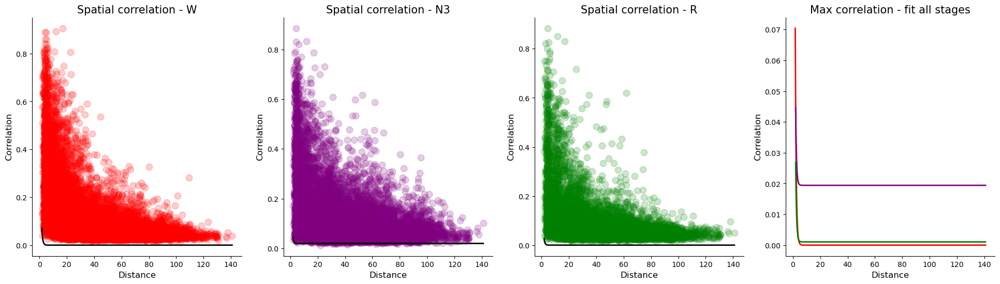

In [36]:
colors_stage = {"W": "r", "N3": "purple", "R": "g"}
print(params_stages_pl)
df_sc_plot = {
    stage: df_sc_bins_stages[stage].rename(columns={"bin": "dist"})
    for stage in ["W", "N3", "R"]
}
fig, axs = plot_sc_fit(
    df_sc_stages, params_stages_pl, colors_stage, data_name="corr_max"
)
plt.show()

## Test with "corrected" cross-correlation measure

In [7]:
df_sc_stages["W"].head()

,ch_1,ch_2,lobe_1,lobe_2,region_1,region_2,mmp_1,mmp_2,dist,corr_0,corr_max,corrc_max,lag_max,pat
0,GD001Lc_11,GD001Lc_12,Temporal,Temporal,Middle temporal gyrus,Middle temporal gyrus,STSvp,STSvp,4.472136,0.372675,0.372675,0.063241,0,1
1,GD001Lc_11,GD001Lc_13,Temporal,Temporal,Middle temporal gyrus,Middle temporal gyrus,STSvp,TE1p,7.000000,0.231053,0.231053,0.062784,0,1
2,GD001Lc_11,GD001Lc_14,Temporal,Temporal,Middle temporal gyrus,Middle temporal gyrus,STSvp,TE1p,12.041595,-0.301700,0.301700,0.168743,0,1
3,GD001Lc_11,GD001Lo_1,Temporal,Frontal,Middle temporal gyrus,Medial frontal cortex,STSvp,10r,97.005155,-0.004742,0.032664,0.041793,-58,1
4,GD001Lc_11,GD001Lo_2,Temporal,Frontal,Middle temporal gyrus,Medial frontal cortex,STSvp,10r,95.336247,-0.008198,0.045241,0.061333,18,1


{'W': array([14.2835862 ,  0.134176  ,  0.05958766]), 'N3': array([13.34797343,  0.06968982,  0.07081236]), 'R': array([10.22226369,  0.07180525,  0.05894373])}


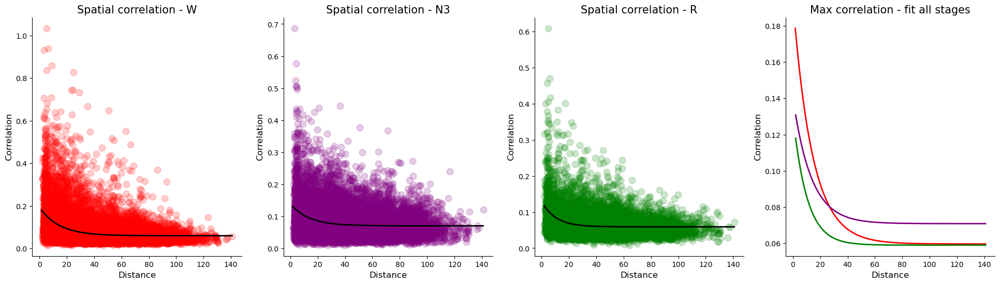

In [40]:
from scipy import optimize


def _exp_decay(x, k, a, b):
    return a * np.exp(-x / k) + b


params_stages_corrc = {}
for stage in ["W", "N3", "R"]:
    x = df_sc_stages[stage]["dist"].to_numpy(dtype=float)
    y = df_sc_stages[stage]["corrc_max"].to_numpy(dtype=float)
    if len(y) < 20:
        popt = np.array([np.nan, np.nan, np.nan])
    popt, pcov = optimize.curve_fit(
        _exp_decay,
        x,
        y,
        bounds=((0, 0, 0), (100, 1, 1)),
    )
    params_stages_corrc[stage] = popt

colors_stage = {"W": "r", "N3": "purple", "R": "g"}
print(params_stages_corrc)
fig, axs = plot_sc_fit(
    df_sc_stages, params_stages_corrc, colors_stage, data_name="corrc_max"
)
plt.show()

Middle temporal gyrus


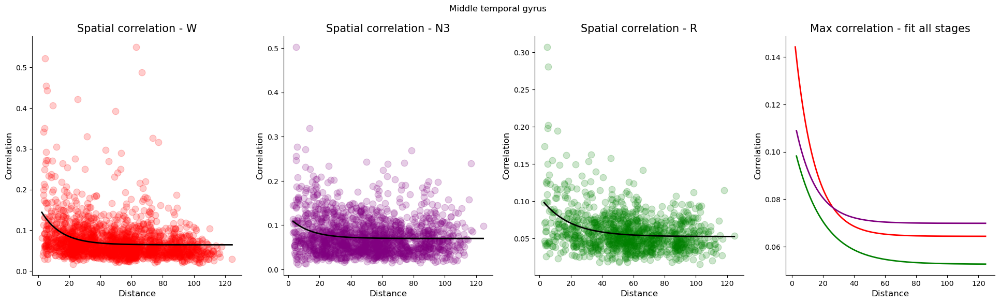

Medial frontal cortex


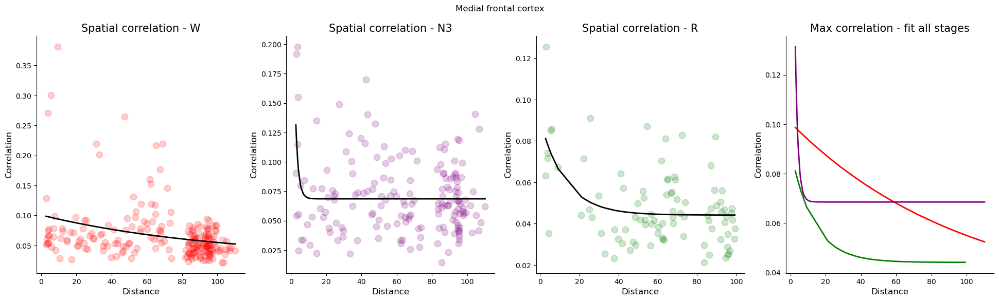

Planum temporale


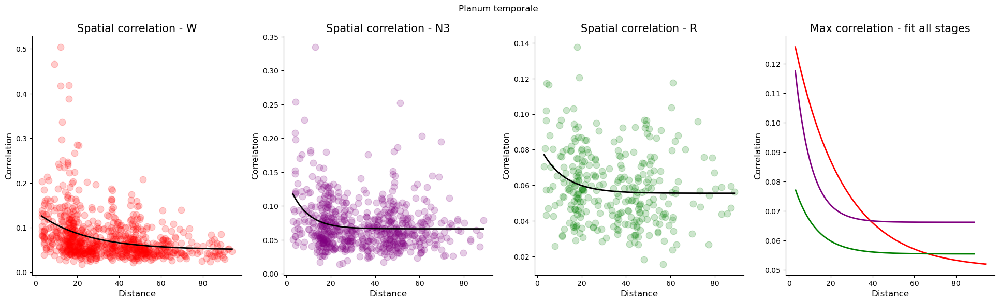

Middle cingulate


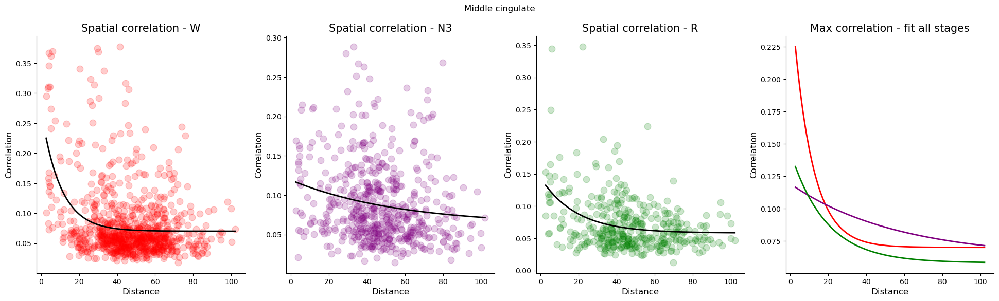

Precentral gyrus


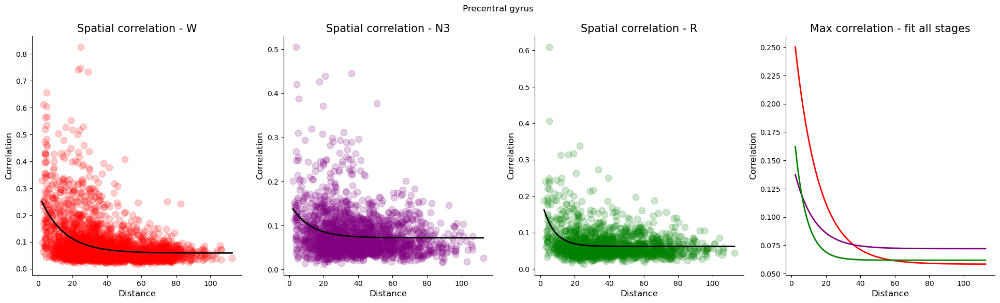

Supplementary motor cortex


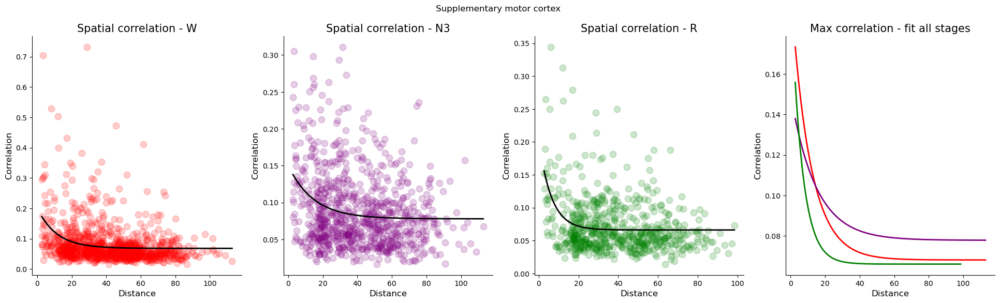

Anterior insula


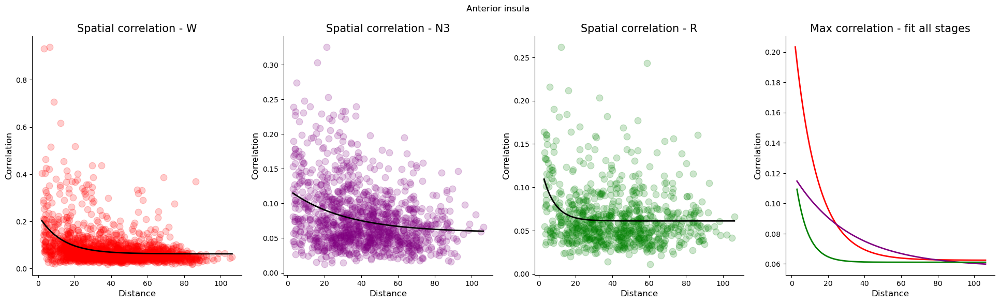

Temporal pole and planum polare


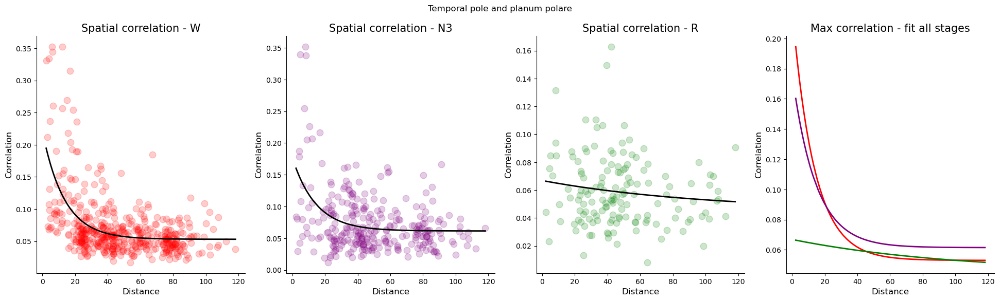

Hippocampus


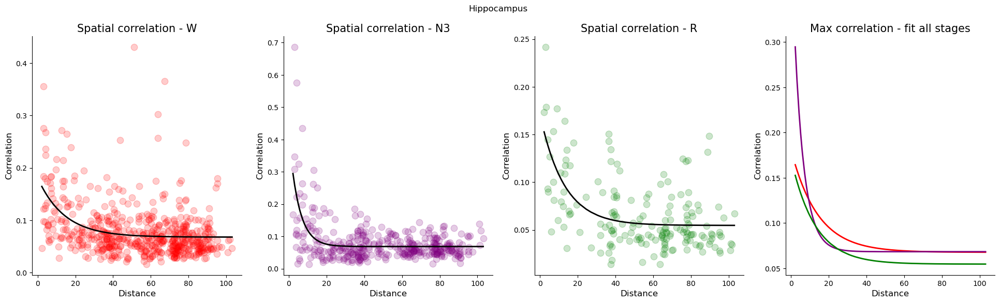

Central operculum


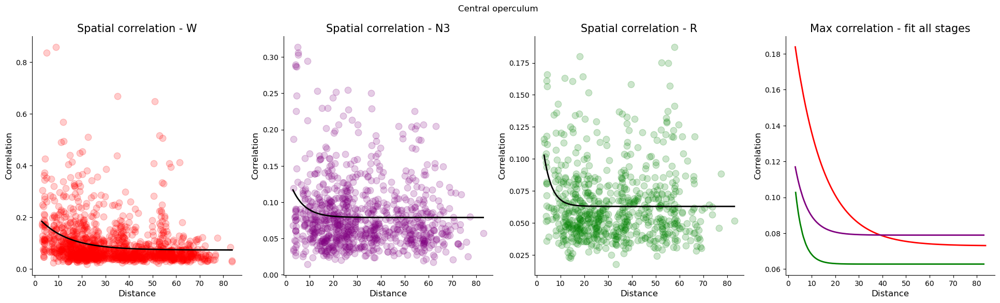

Transverse temporal gyrus


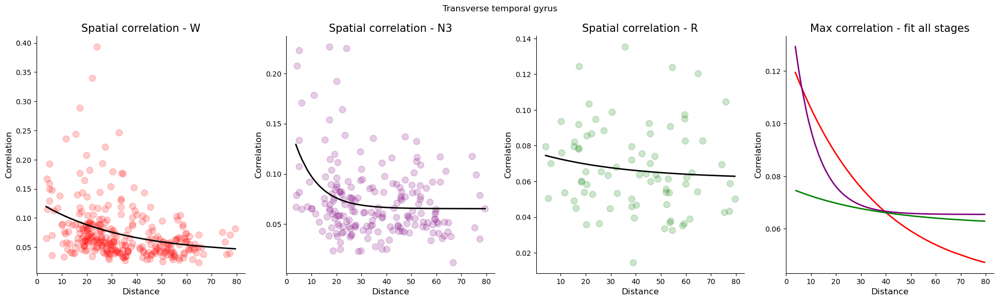

Lingual gyrus and occipital fusiform gyrus


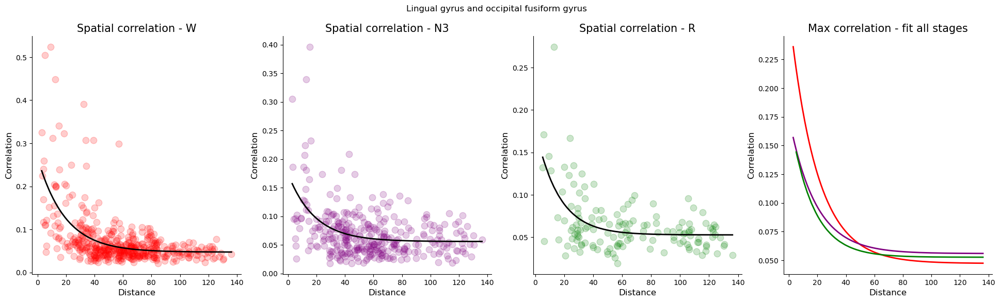

Fusiform and parahippocampal gyri


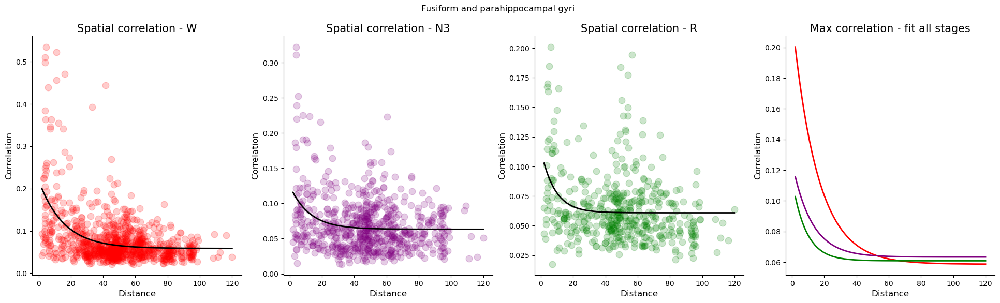

Inferior temporal gyrus


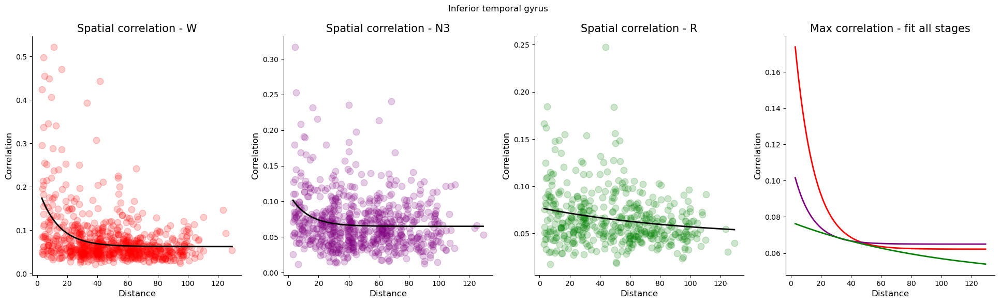

Postcentral gyrus (including medial segment)


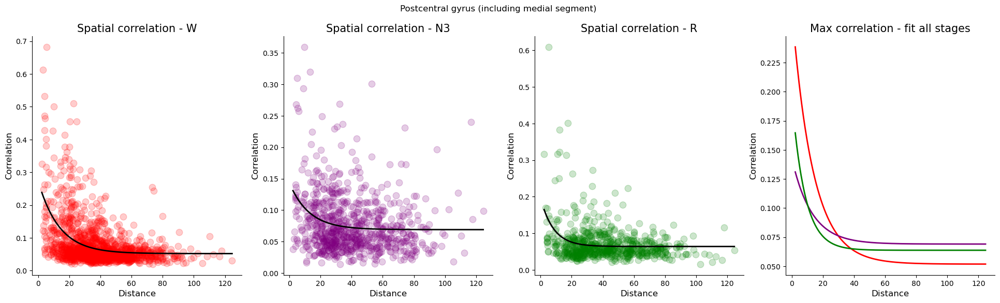

Precuneus


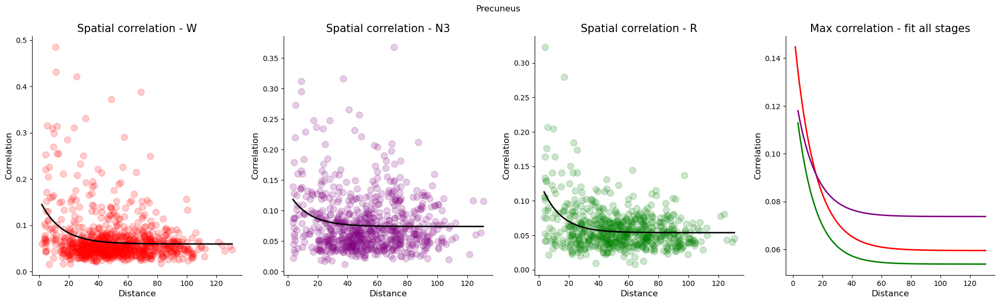

Angular gyrus


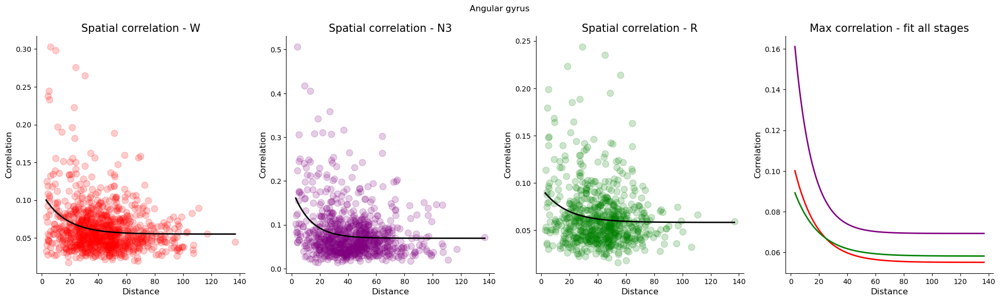

Opercular part of inferior frontal gyrus


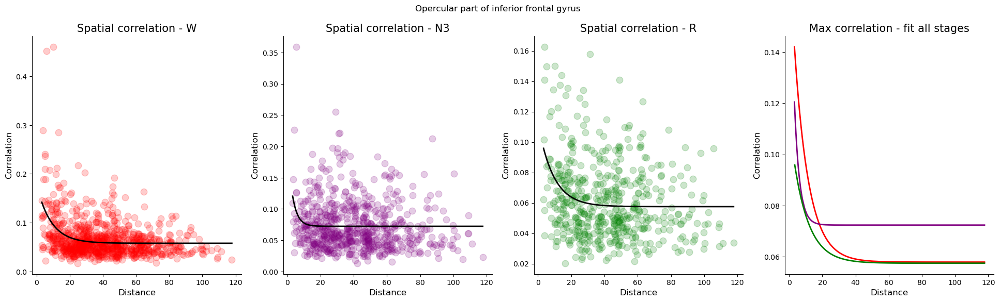

Parietal operculum


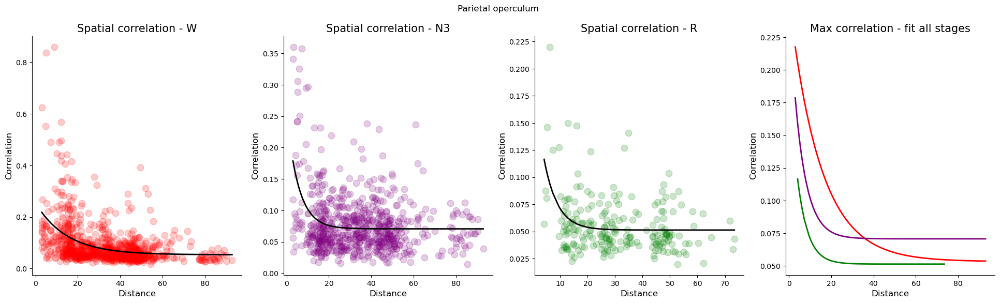

Frontal operculum


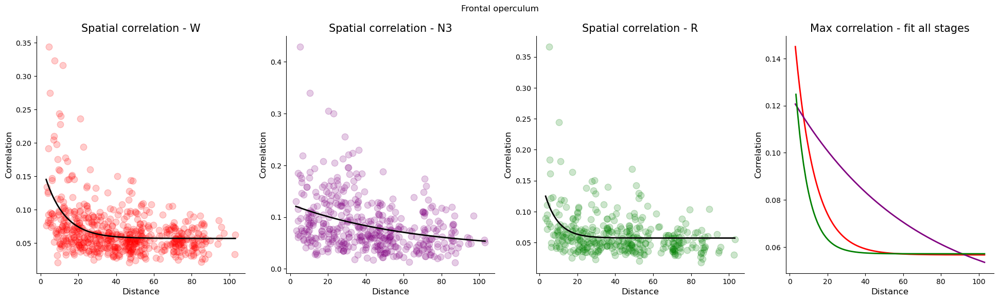

Triangular part of inferior frontal gyrus


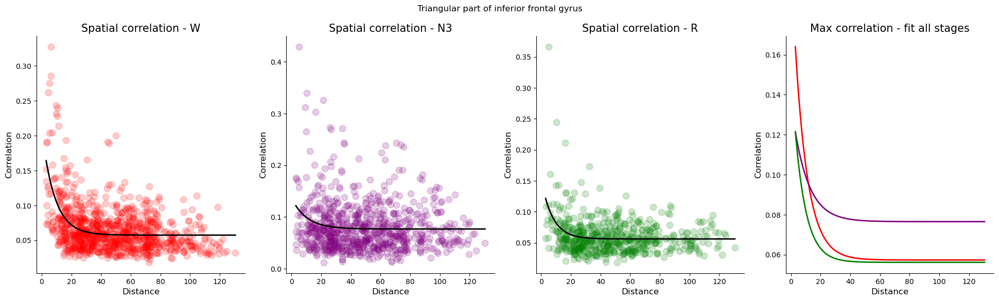

Middle frontal gyrus


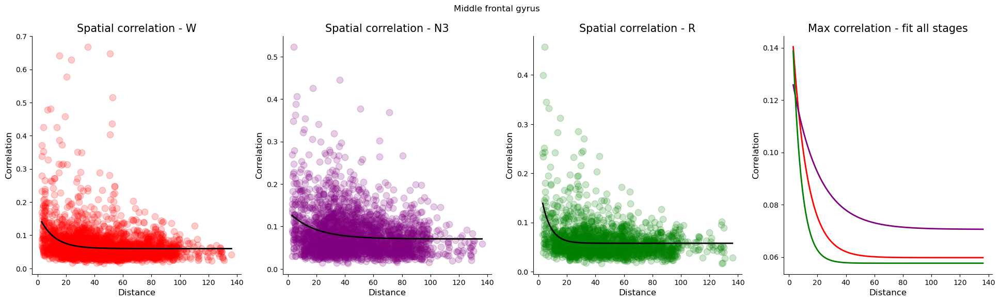

Anterior cingulate


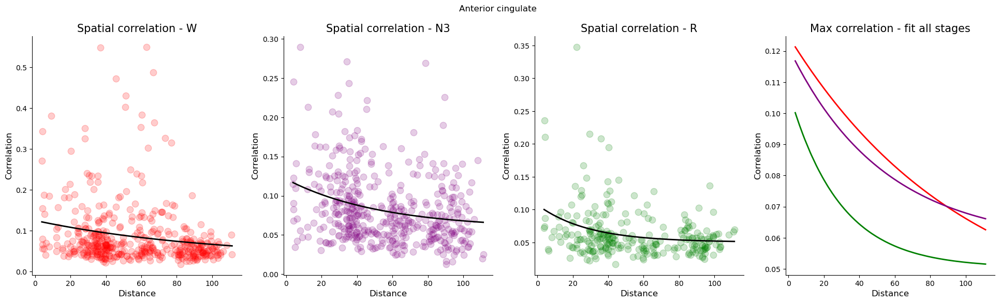

Superior temporal gyrus


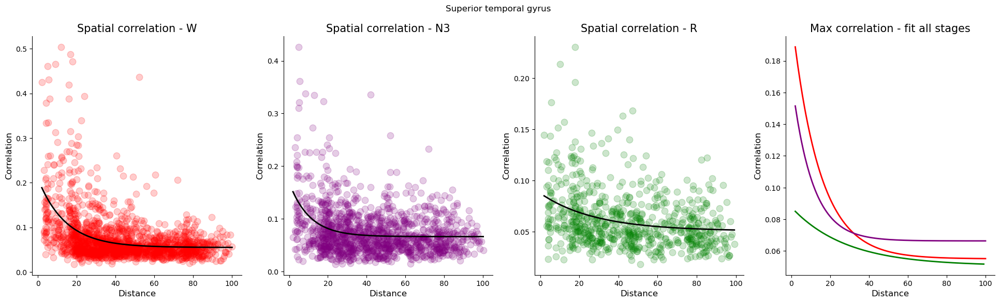

Posterior insula


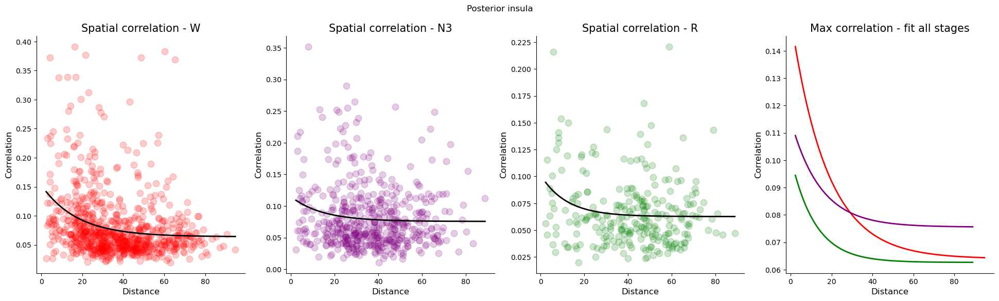

Medial segment of precentral gyrus


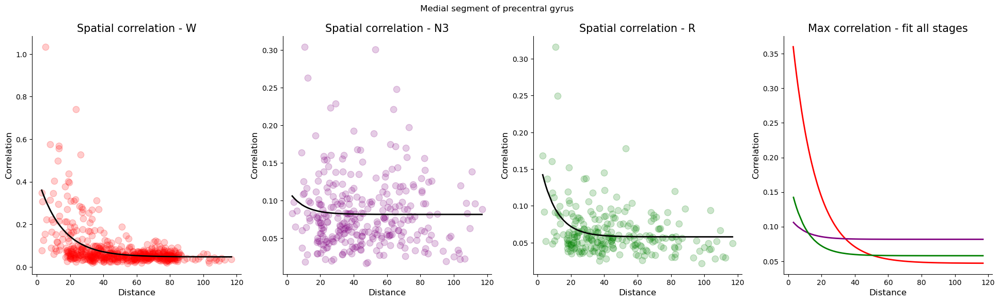

Medial segment of superior frontal gyrus


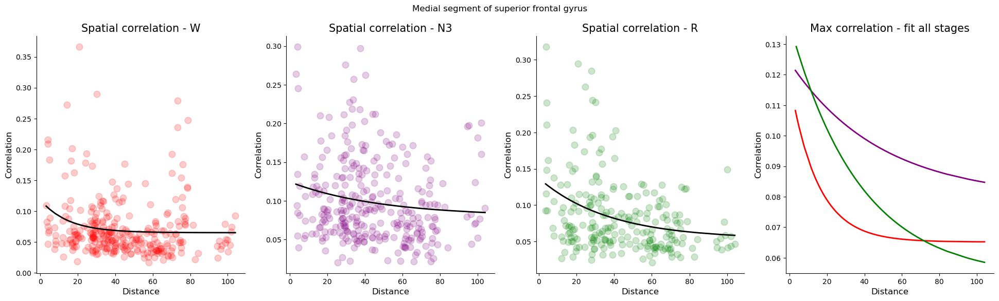

Superior frontal gyrus and frontal pole


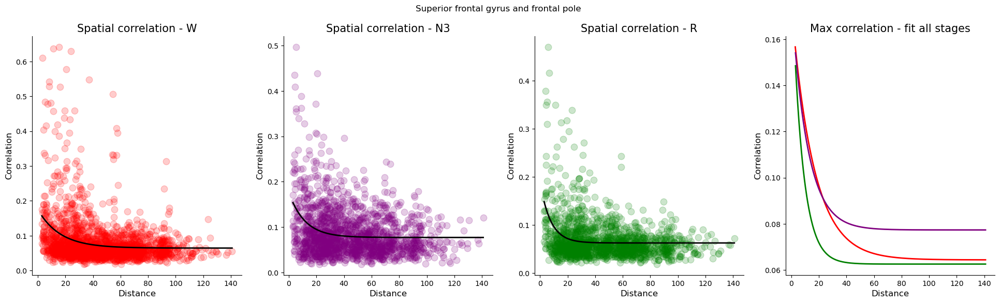

Superior parietal lobule


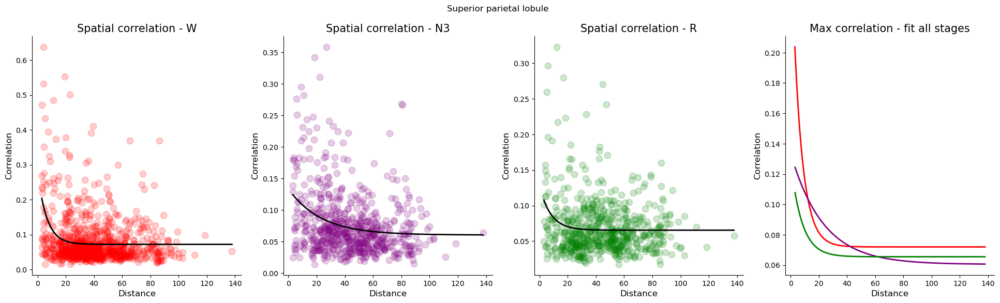

Posterior cingulate


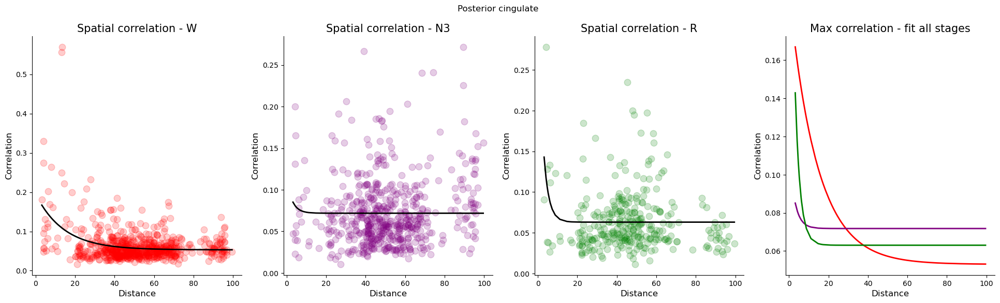

Supramarginal gyrus


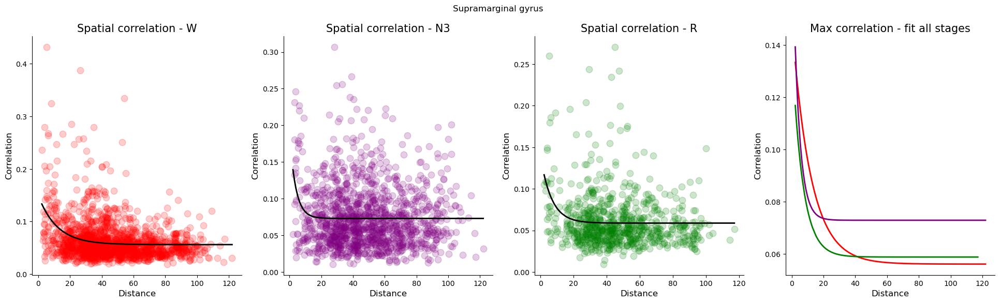

Gyrus rectus and orbital gyri


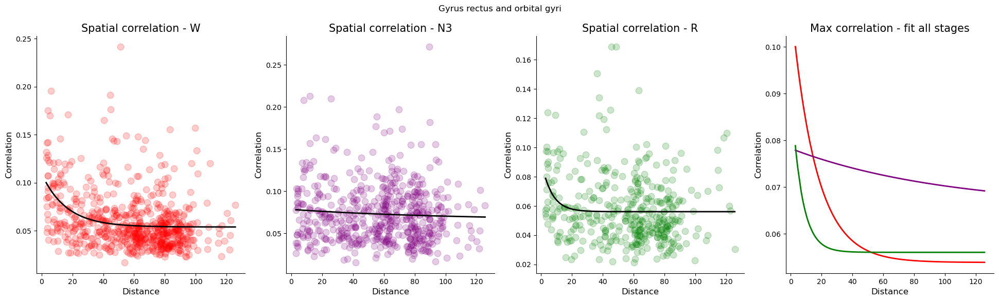

Amygdala


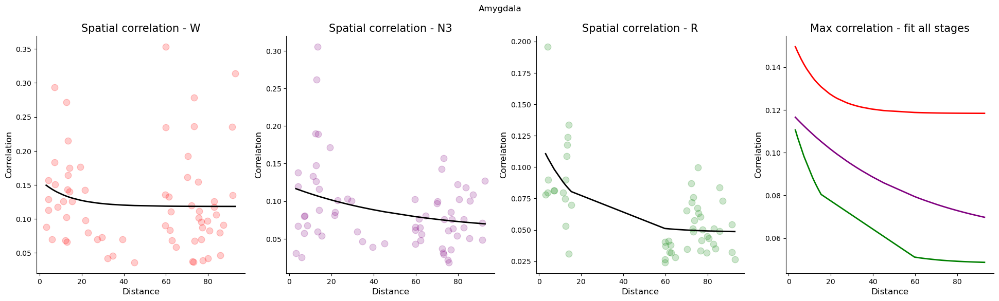

Inferior ocipital gyrus and occipital pole


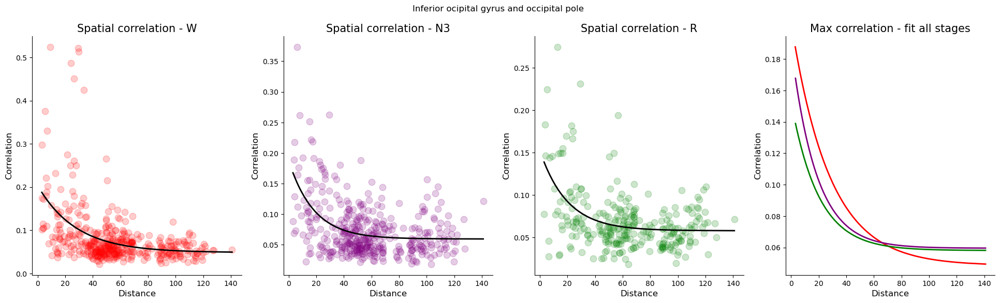

Calcarine cortex


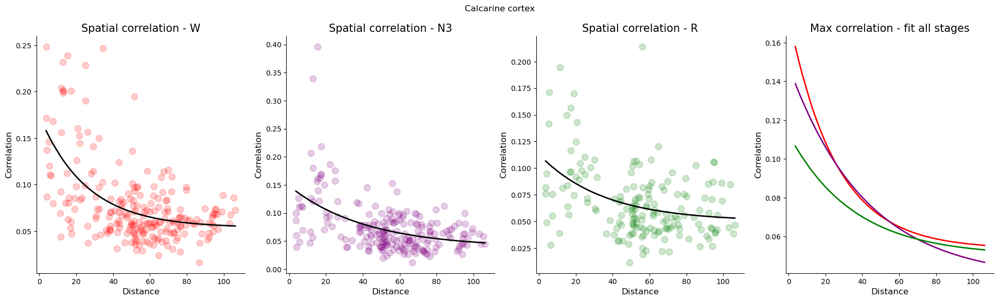

Superior and middle occipital gyri


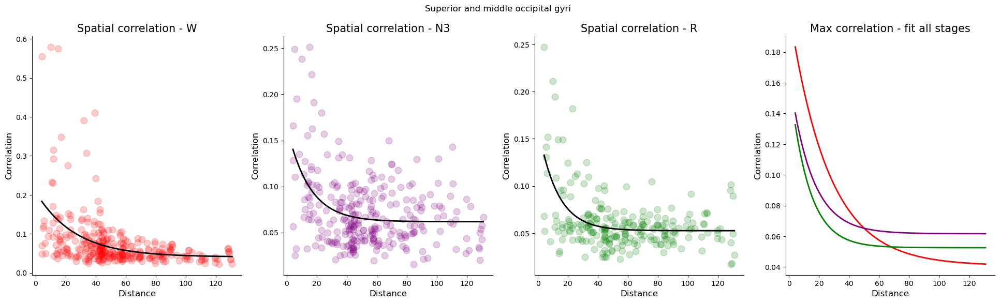

Cuneus


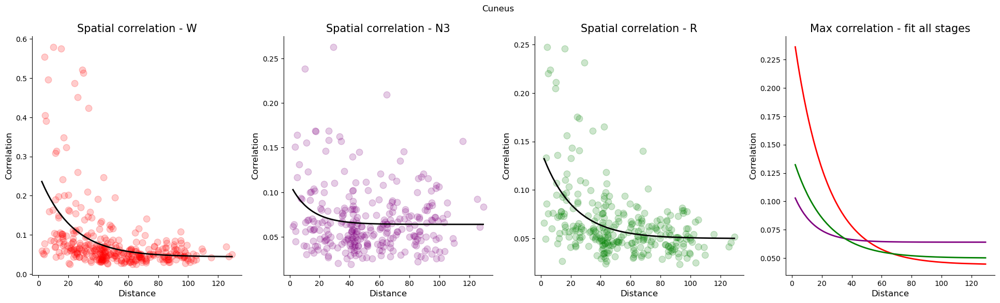

Orbital part of inferior frontal gyrus


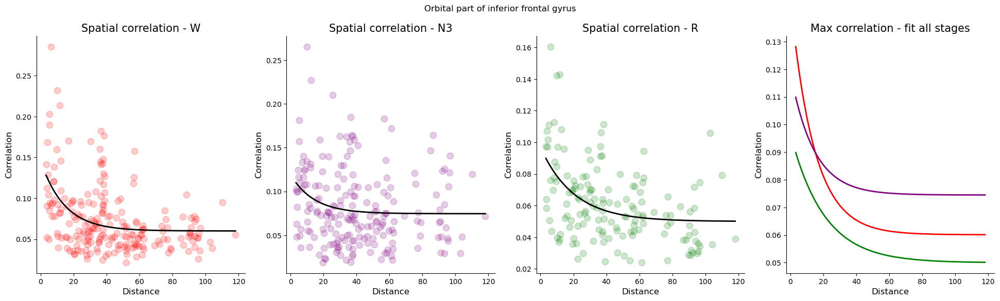

In [55]:
colors_stage = {"W": "r", "N3": "purple", "R": "g"}
params_stages_corrc_all = {}
for region in df_sc_params_mni_stages["W"].index:
    print(region)
    params_stages_corrc_all[region] = {}
    df_sc_stages_region = {
        stage: df_sc_stages[stage][
            (df_sc_stages[stage]["region_1"] == region)
            | (df_sc_stages[stage]["region_2"] == region)
        ]
        for stage in ["W", "N3", "R"]
    }
    for stage in ["W", "N3", "R"]:
        x = df_sc_stages_region[stage]["dist"].to_numpy(dtype=float)
        y = df_sc_stages_region[stage]["corrc_max"].to_numpy(dtype=float)
        if len(y) < 20:
            popt = np.array([np.nan, np.nan, np.nan])
        popt, pcov = optimize.curve_fit(
            _exp_decay,
            x,
            y,
            bounds=((0, 0, 0), (100, 1, 1)),
        )
        params_stages_corrc_all[region][stage] = popt
    fig, axs = plot_sc_fit(
        df_sc_stages_region,
        params_stages_corrc_all[region],
        colors_stage,
        data_name="corrc_max",
    )
    fig.suptitle(region)
    plt.show()

Similarity with "non-corrected" parameters:

W
k - rho = -0.09490650653136003, p = 0.5708626680344717
a - rho = 0.4708716811250249, p = 0.002848194633914849
b - rho = 0.682005304478977, p = 2.4161400600589913e-06


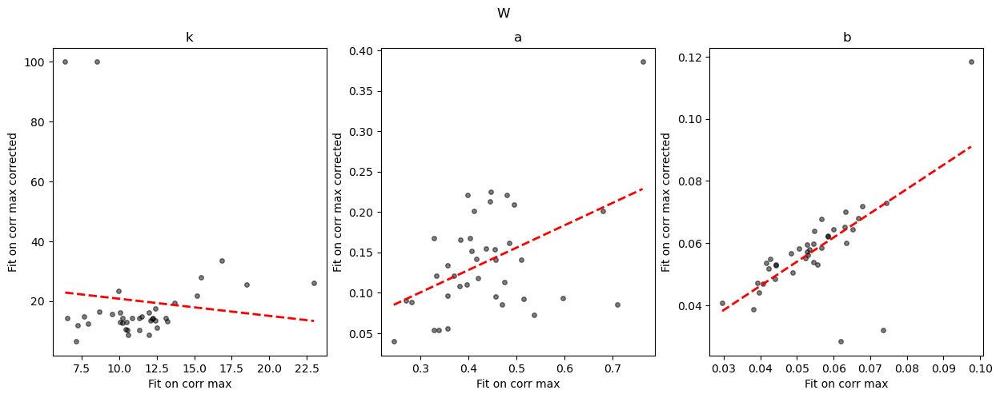

N3
k - rho = 0.35271517361529725, p = 0.029856140031173643
a - rho = 0.16589727723464323, p = 0.31953347776449054
b - rho = 0.6228087987011598, p = 2.9703254779470108e-05


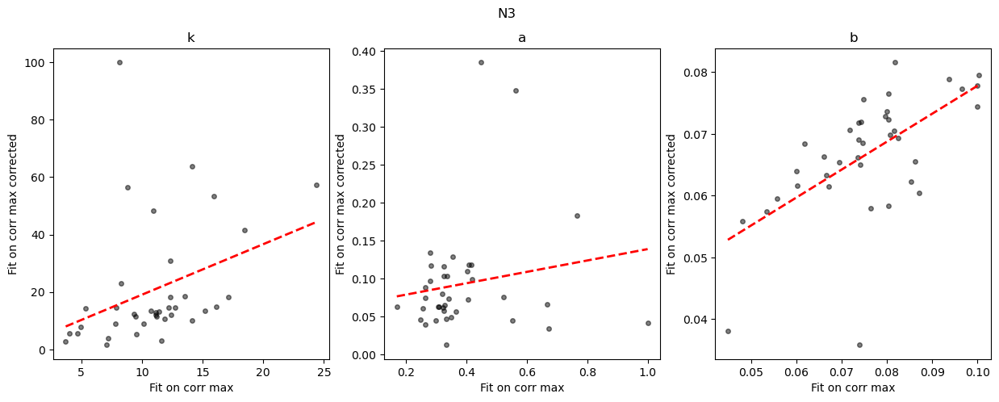

R
k - rho = 0.17649249198006334, p = 0.2891547108710739
a - rho = 0.4846423659173115, p = 0.00204578661480898
b - rho = 0.5190314743306556, p = 0.0008412410081887672


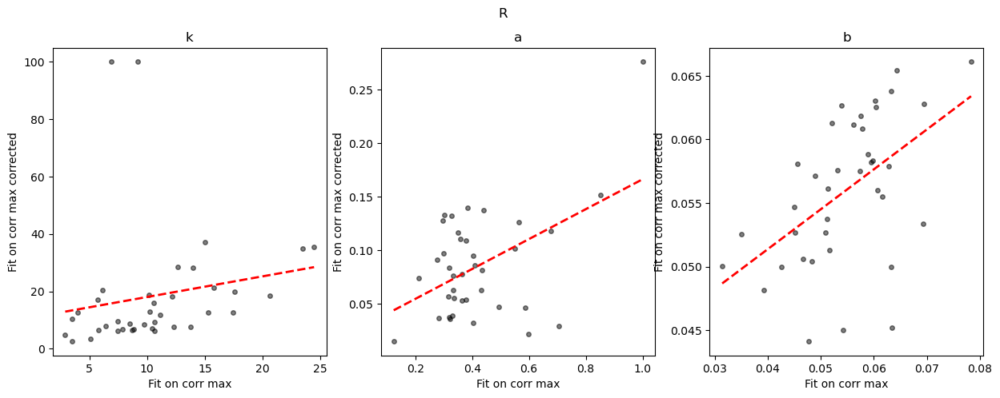

In [48]:
for stage in ["W", "N3", "R"]:
    print(stage)
    plt.figure(figsize=(15, 5))
    for i, name in enumerate(["k", "a", "b"]):
        plt.subplot(1, 3, i + 1)
        params_regions_stage = np.array(
            [params_stages_all[reg][stage] for reg in params_stages_all.keys()]
        ).astype(float)
        params_regions_stage_corr = np.array(
            [
                params_stages_corrc_all[reg][stage]
                for reg in params_stages_corrc_all.keys()
            ]
        ).astype(float)
        plt.plot(
            params_regions_stage[:, i],
            params_regions_stage_corr[:, i],
            "ko",
            ms=4,
            alpha=0.5,
        )
        m, q, r, p, _ = linregress(
            params_regions_stage[:, i], params_regions_stage_corr[:, i]
        )
        print(f"{name} - rho = {r}, p = {p}")
        x_plot = np.linspace(
            params_regions_stage[:, i].min(), params_regions_stage[:, i].max(), 100
        )
        plt.plot(x_plot, m * x_plot + q, "r--", lw=2)
        plt.title(f"{name}")
        plt.xlabel("Fit on corr max")
        plt.ylabel("Fit on corr max corrected")
        plt.suptitle(stage)
    plt.show()

With bins:

{'W': array([16.0867061 ,  0.12247505,  0.05819904]), 'N3': array([14.98605097,  0.06269331,  0.07033778]), 'R': array([16.74879209,  0.05114002,  0.05646625])}


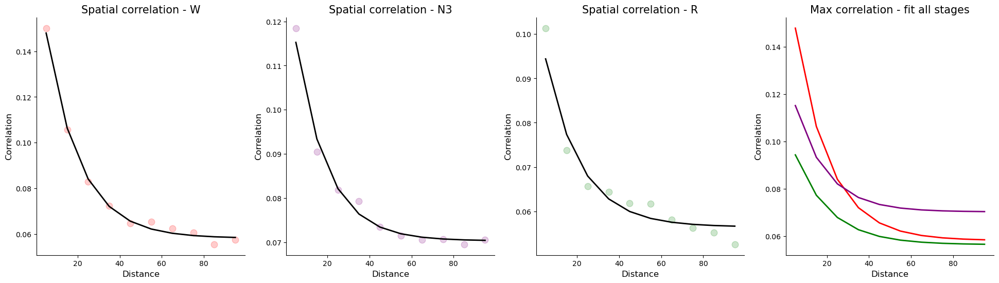

In [39]:
params_stages_corrc = {}
for stage in ["W", "N3", "R"]:
    x = df_sc_bins_stages[stage]["bin"].to_numpy(dtype=float)
    y = df_sc_bins_stages[stage]["corrc_max"].to_numpy(dtype=float)
    yerr = df_sc_bins_stages[stage]["corrc_max_sem"].to_numpy(dtype=float)
    if len(y) < 2:
        popt = np.array([np.nan, np.nan, np.nan])
    popt, pcov = optimize.curve_fit(
        _exp_decay,
        x,
        y,
        sigma=yerr,
        bounds=((0, 0, 0), (100, 1, 1)),
    )
    params_stages_corrc[stage] = popt

colors_stage = {"W": "r", "N3": "purple", "R": "g"}
print(params_stages_corrc)
df_sc_plot = {
    stage: df_sc_bins_stages[stage].rename(columns={"bin": "dist"})
    for stage in ["W", "N3", "R"]
}
fig, axs = plot_sc_fit(
    df_sc_plot, params_stages_corrc, colors_stage, data_name="corrc_max"
)
plt.show()

Middle temporal gyrus


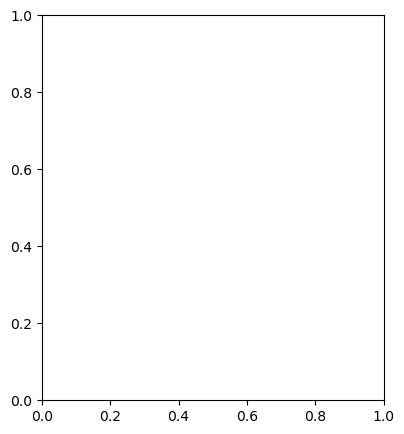

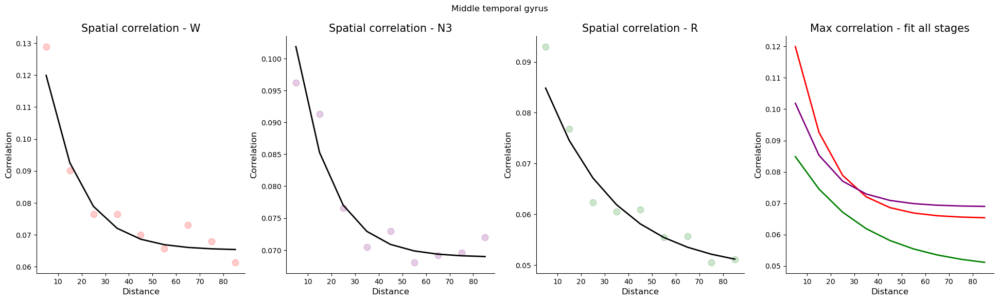

Medial frontal cortex


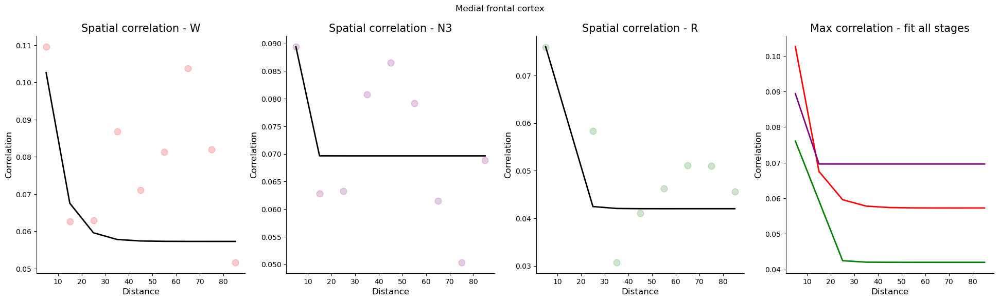

Planum temporale


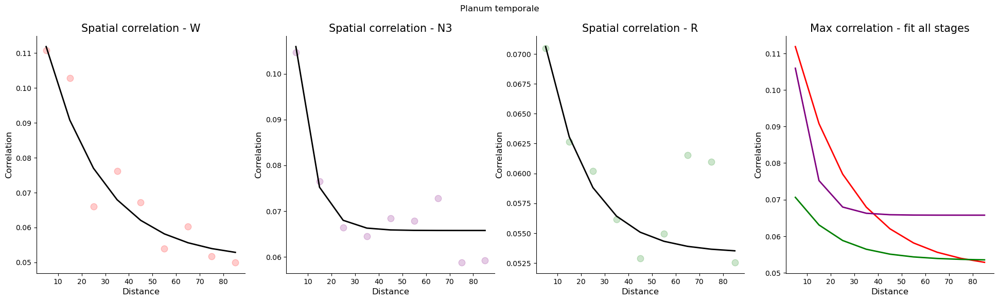

Middle cingulate


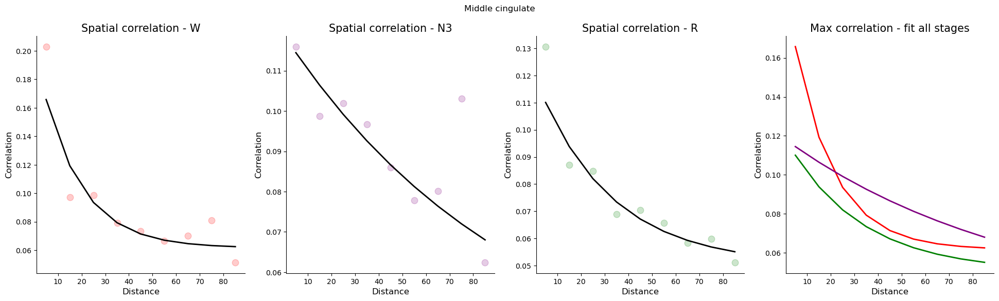

Precentral gyrus


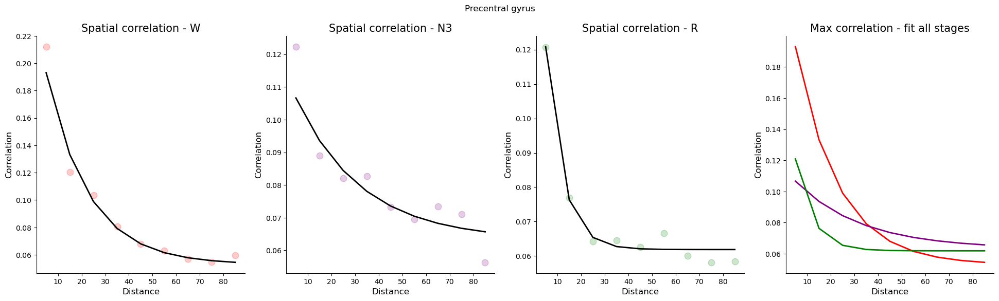

Supplementary motor cortex


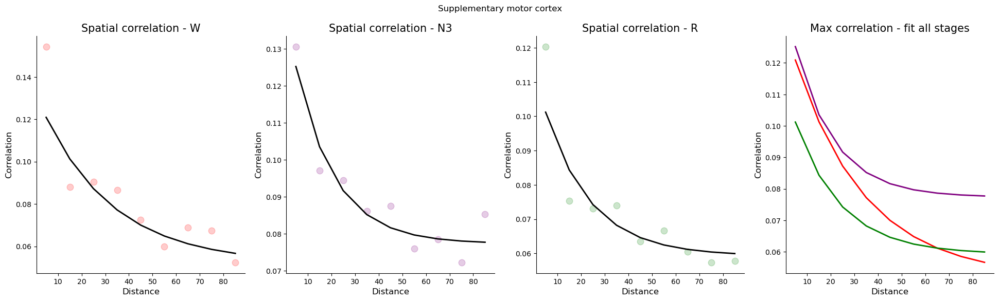

Anterior insula


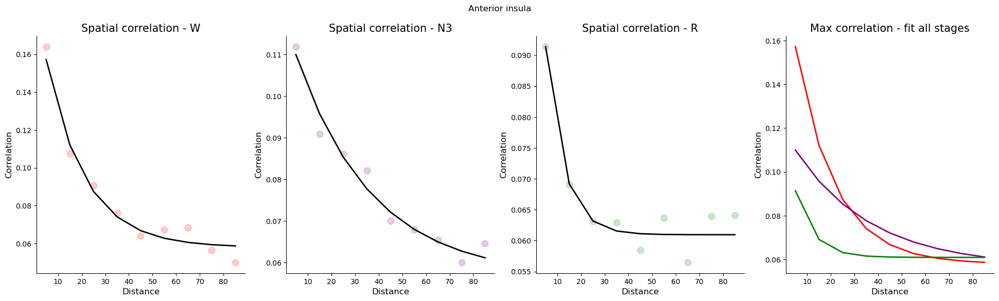

Temporal pole and planum polare


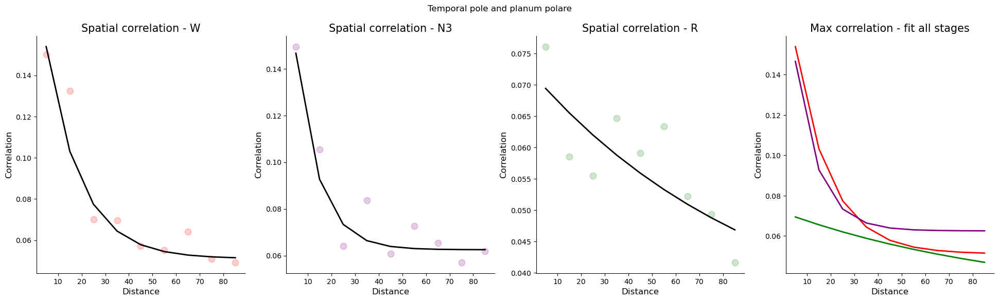

Hippocampus


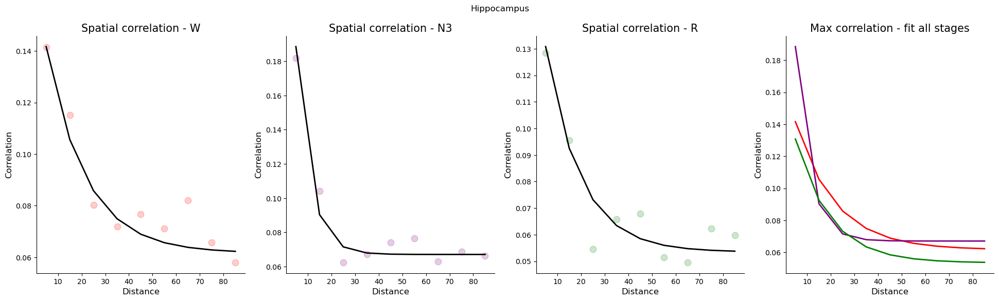

Central operculum


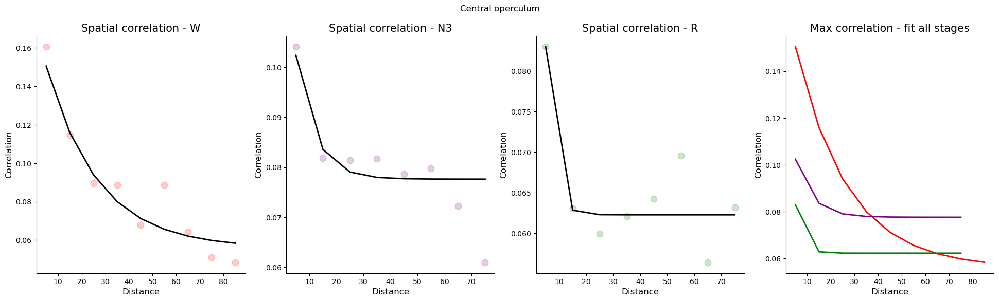

Transverse temporal gyrus


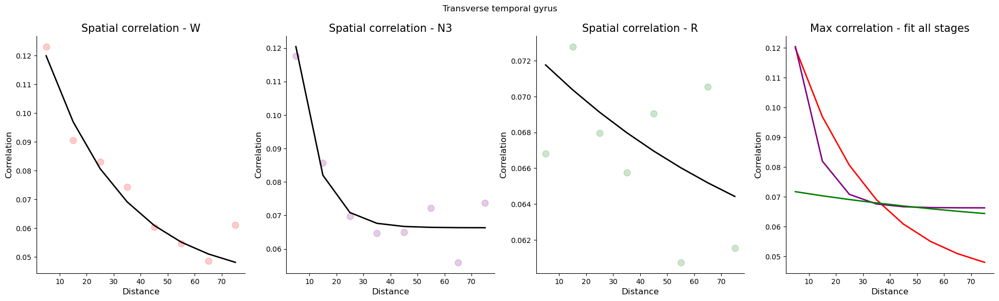

Lingual gyrus and occipital fusiform gyrus


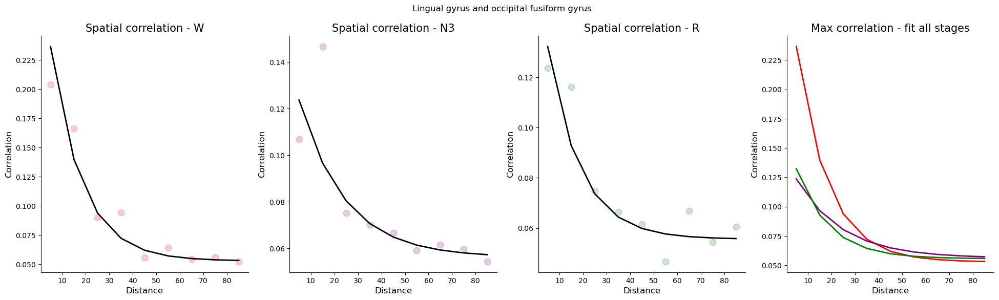

Fusiform and parahippocampal gyri


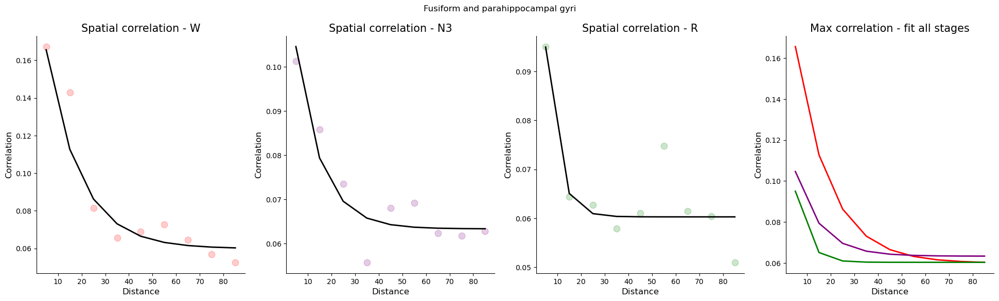

Inferior temporal gyrus


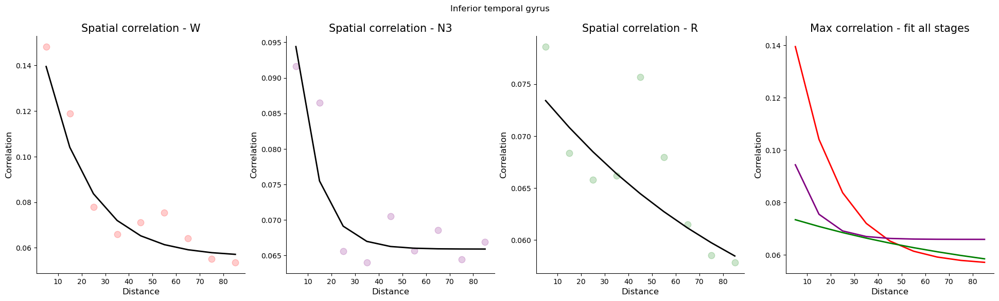

Postcentral gyrus (including medial segment)


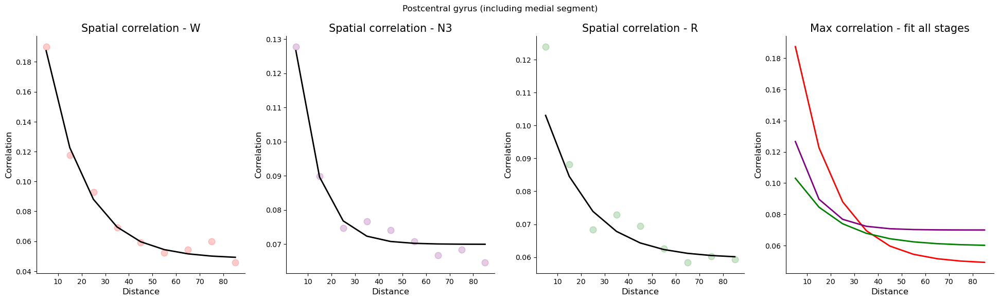

Precuneus


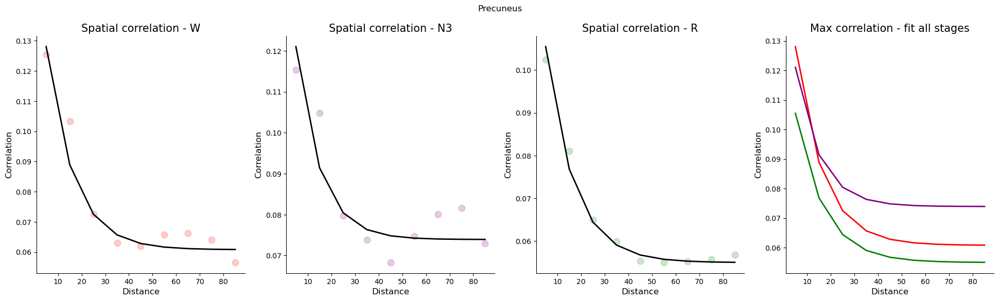

Angular gyrus


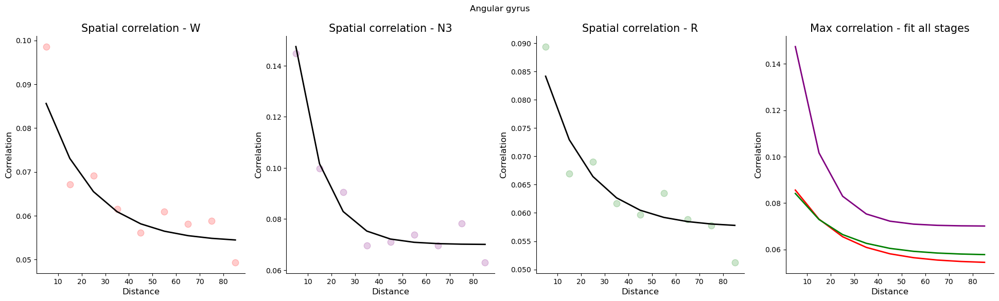

Opercular part of inferior frontal gyrus


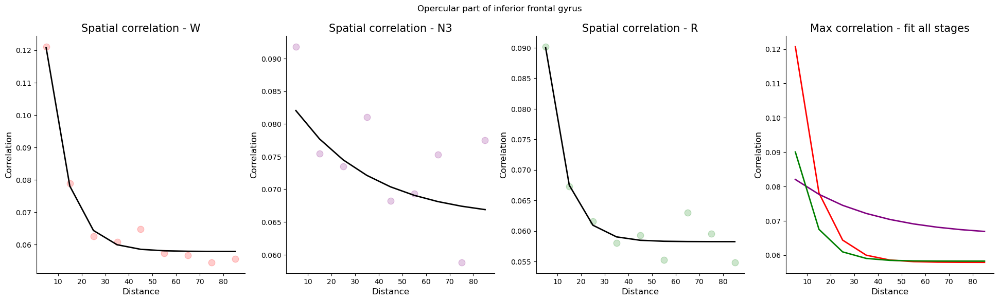

Parietal operculum


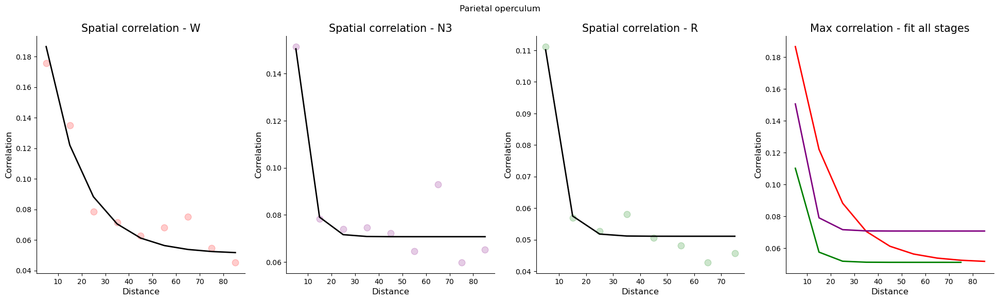

Frontal operculum


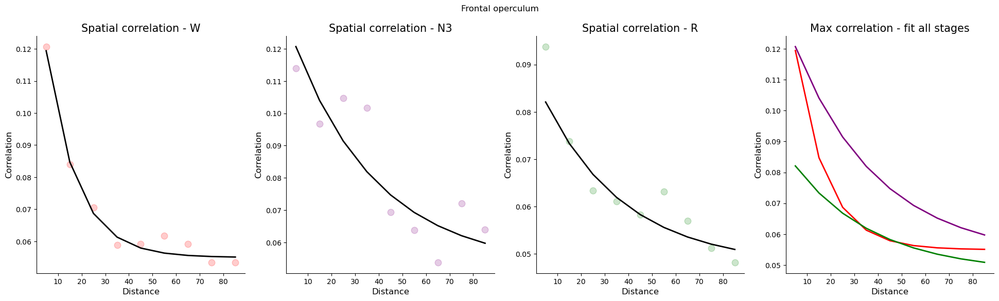

Triangular part of inferior frontal gyrus


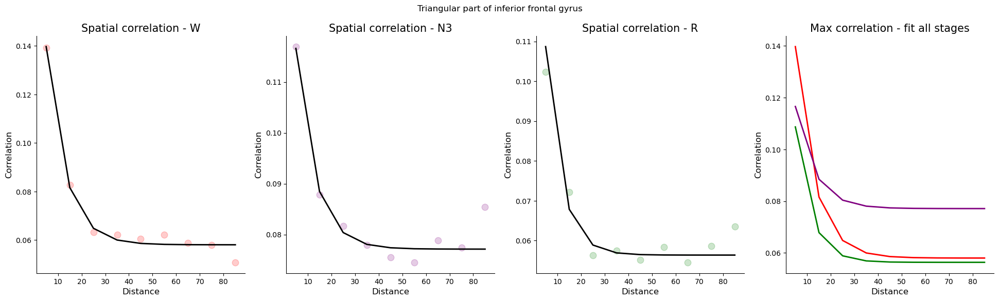

Middle frontal gyrus


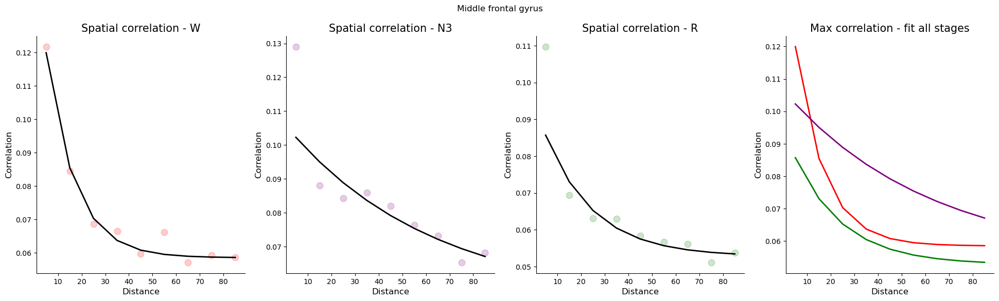

Anterior cingulate


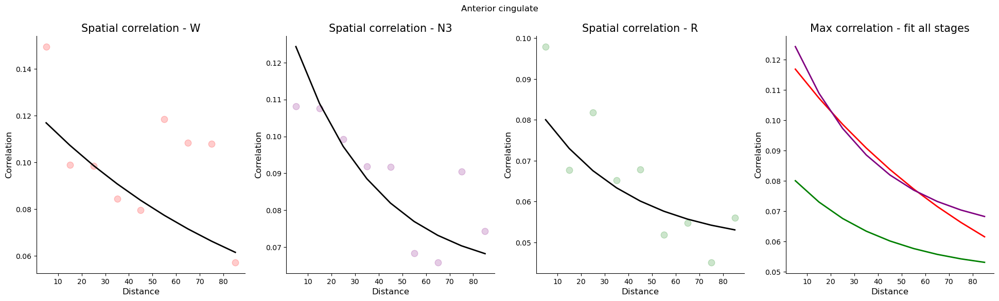

Superior temporal gyrus


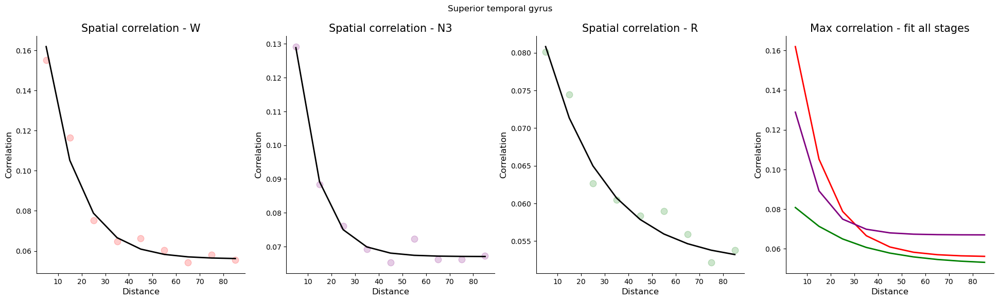

Posterior insula


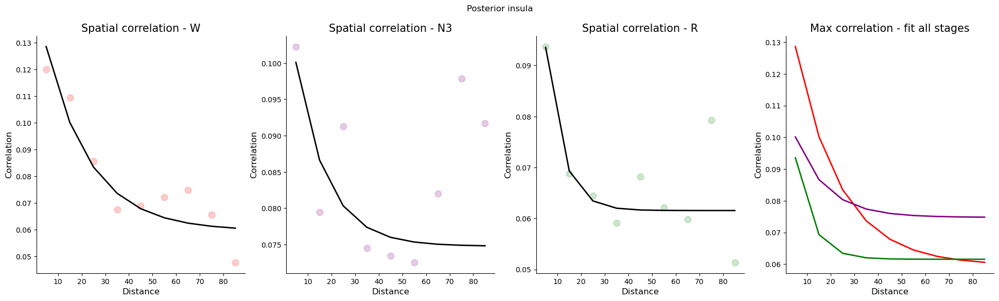

Medial segment of precentral gyrus


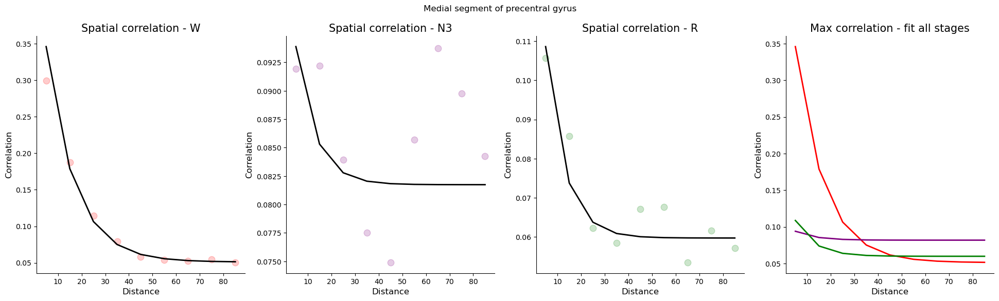

Medial segment of superior frontal gyrus


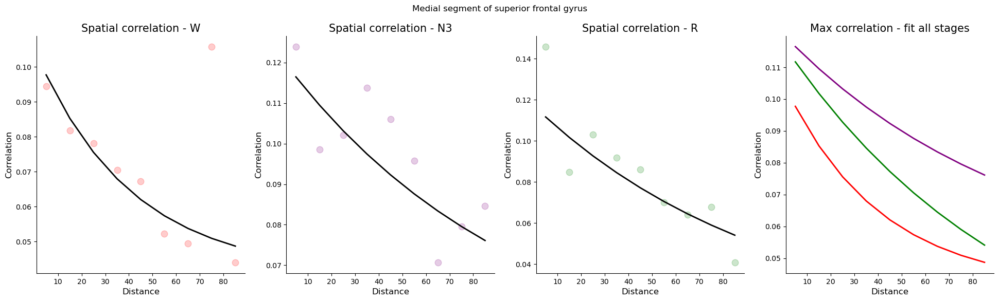

Superior frontal gyrus and frontal pole


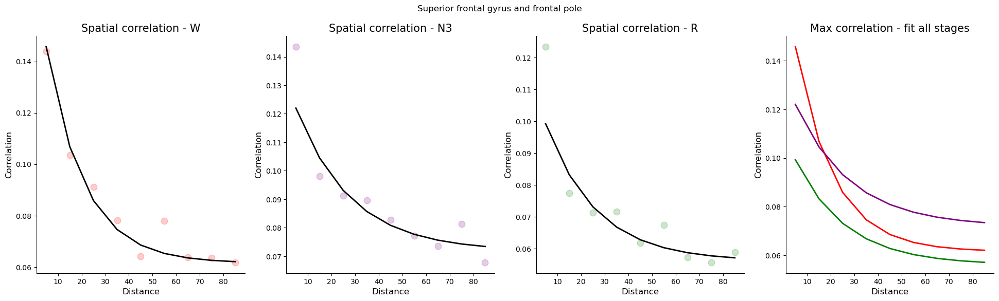

Superior parietal lobule


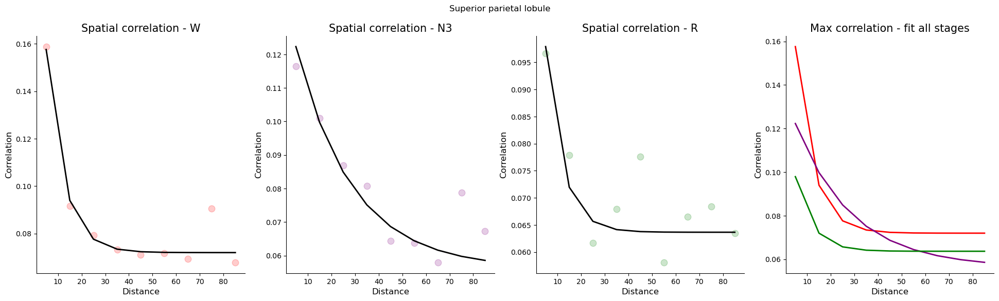

Posterior cingulate


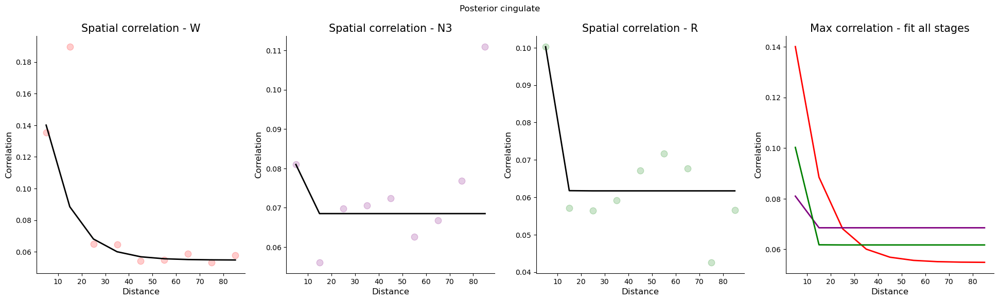

Supramarginal gyrus


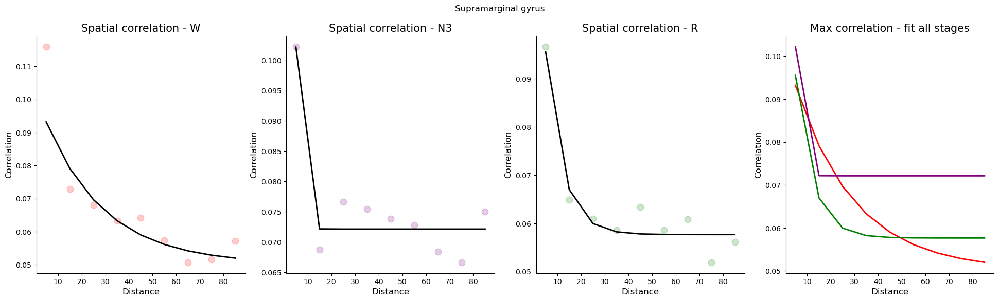

Gyrus rectus and orbital gyri


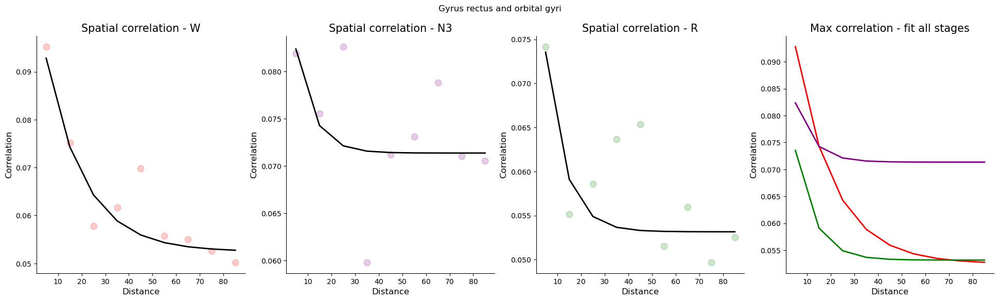

Amygdala


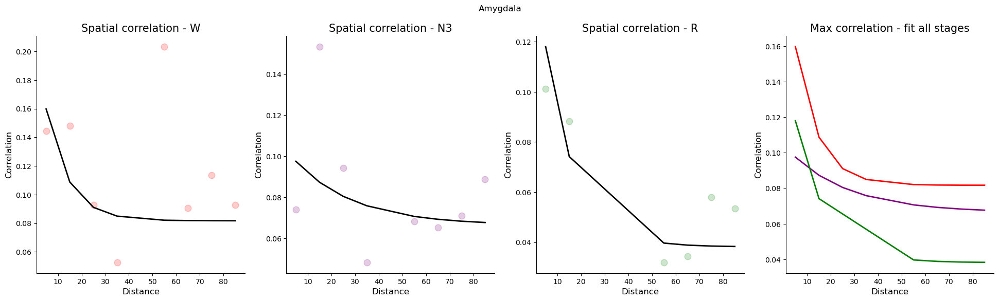

Inferior ocipital gyrus and occipital pole


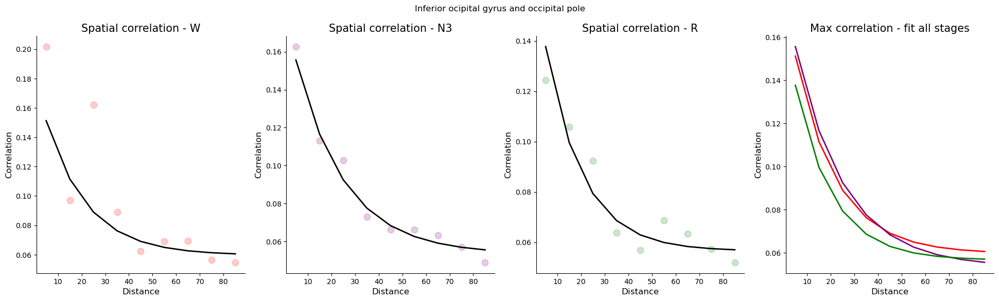

Calcarine cortex


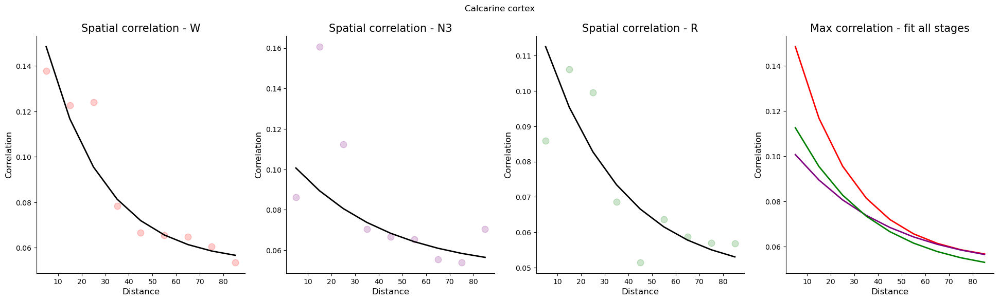

Superior and middle occipital gyri


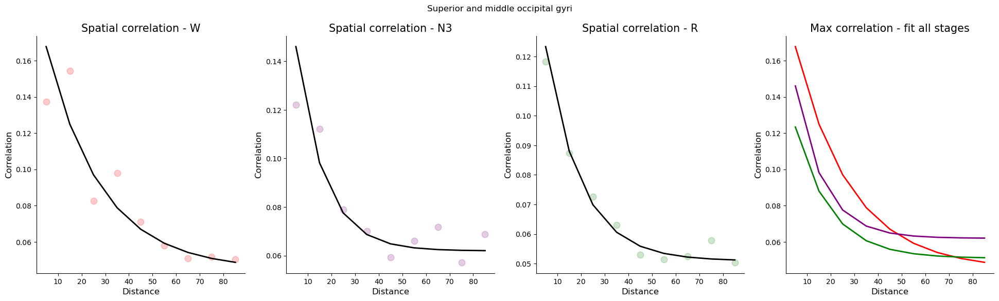

Cuneus


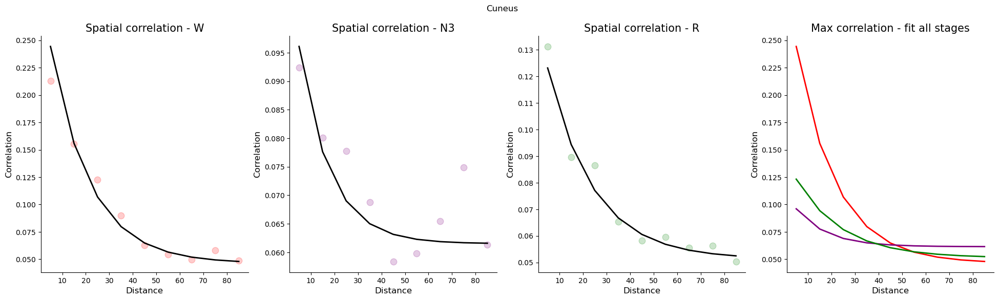

Orbital part of inferior frontal gyrus


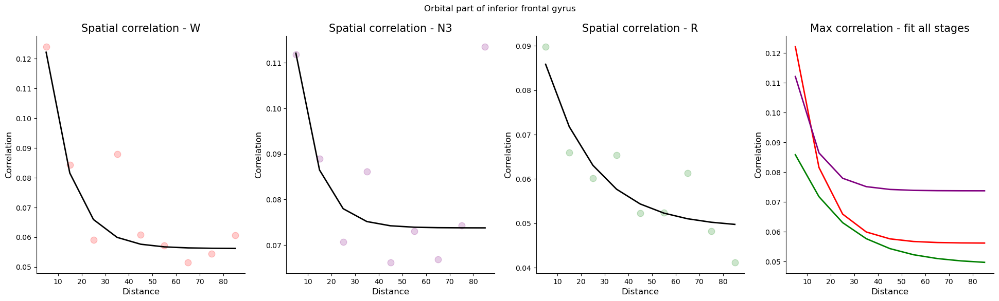

In [53]:
colors_stage = {"W": "r", "N3": "purple", "R": "g"}
params_stages_corrc_bins = {}
for region in df_sc_params_mni_stages["W"].index:
    print(region)
    params_stages_corrc_bins[region] = {}
    df_sc_stages_region = {
        stage: df_sc_stages[stage][
            (df_sc_stages[stage]["region_1"] == region)
            | (df_sc_stages[stage]["region_2"] == region)
        ]
        for stage in ["W", "N3", "R"]
    }
    df_sc_stages_region = {
        stage: uti.compute_sc_bin(df_sc_reg, bins=np.arange(0, 100, 10)).rename(
            columns={"bin": "dist"}
        )
        for stage, df_sc_reg in df_sc_stages_region.items()
    }
    for stage in ["W", "N3", "R"]:
        x = df_sc_stages_region[stage]["dist"].to_numpy(dtype=float)
        y = df_sc_stages_region[stage]["corrc_max"].to_numpy(dtype=float)
        yerr = df_sc_stages_region[stage]["corrc_max_sem"].to_numpy(dtype=float)
        if len(y) < 2:
            popt = np.array([np.nan, np.nan, np.nan])
        popt, pcov = optimize.curve_fit(
            _exp_decay,
            x,
            y,
            sigma=yerr,
            bounds=((0, 0, 0), (100, 1, 1)),
        )
        params_stages_corrc_bins[region][stage] = popt
    fig, axs = plot_sc_fit(
        df_sc_stages_region,
        params_stages_corrc_bins[region],
        colors_stage,
        data_name="corrc_max",
    )
    fig.suptitle(region)
    plt.show()

W
k - rho = 0.013261811522233437, p = 0.937013723369345
a - rho = 0.45951121001269213, p = 0.00370492056874124
b - rho = 0.3413004193019829, p = 0.03598780061821485


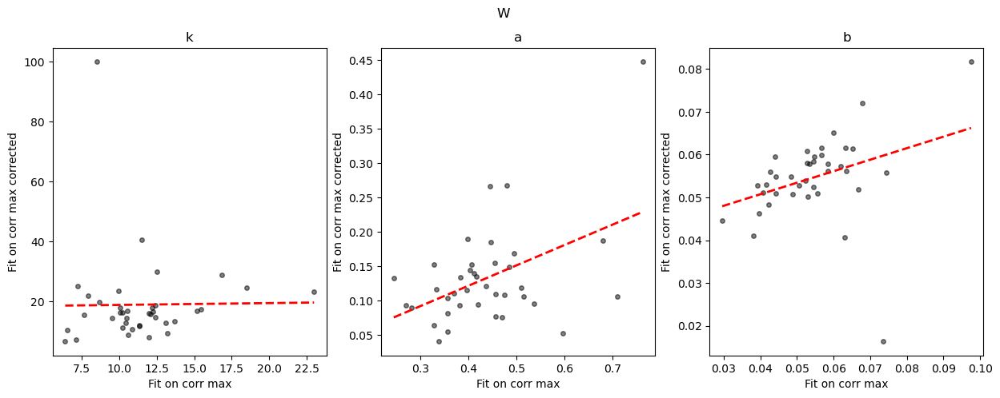

N3
k - rho = 0.22707954373407335, p = 0.1703626464410582
a - rho = 0.467657880460383, p = 0.003070928260987261
b - rho = 0.222510926643923, p = 0.17935821674346694


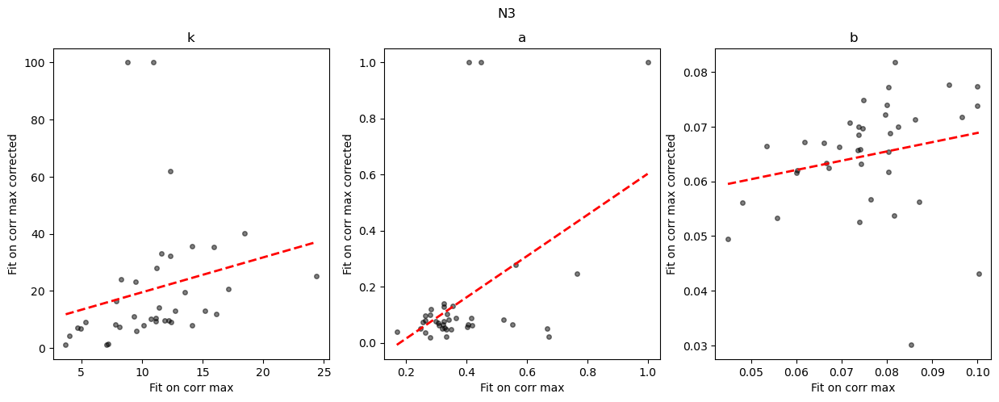

R
k - rho = 0.32947271068725703, p = 0.04338839496403308
a - rho = 0.6157160289343491, p = 3.877876040797646e-05
b - rho = 0.10901607808240864, p = 0.5147124866258785


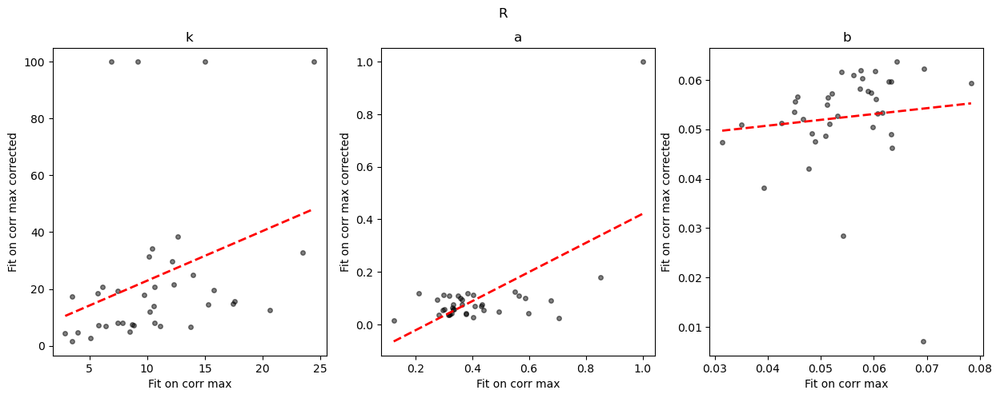

In [54]:
for stage in ["W", "N3", "R"]:
    print(stage)
    plt.figure(figsize=(15, 5))
    for i, name in enumerate(["k", "a", "b"]):
        plt.subplot(1, 3, i + 1)
        params_regions_stage = np.array(
            [params_stages_all[reg][stage] for reg in params_stages_all.keys()]
        ).astype(float)
        params_regions_stage_corr = np.array(
            [
                params_stages_corrc_bins[reg][stage]
                for reg in params_stages_corrc_bins.keys()
            ]
        ).astype(float)
        plt.plot(
            params_regions_stage[:, i],
            params_regions_stage_corr[:, i],
            "ko",
            ms=4,
            alpha=0.5,
        )
        m, q, r, p, _ = linregress(
            params_regions_stage[:, i], params_regions_stage_corr[:, i]
        )
        print(f"{name} - rho = {r}, p = {p}")
        x_plot = np.linspace(
            params_regions_stage[:, i].min(), params_regions_stage[:, i].max(), 100
        )
        plt.plot(x_plot, m * x_plot + q, "r--", lw=2)
        plt.title(f"{name}")
        plt.xlabel("Fit on corr max")
        plt.ylabel("Fit on corr max corrected")
        plt.suptitle(stage)
    plt.show()

#### Comparison with tau

In [57]:
# Dataframe with timescales for all electrodes
df_tau = pd.read_csv(res_tau_path.joinpath("all_tau.csv"), index_col=0)
map_coords = pd.read_csv(data_path.joinpath("mnia_centroids_coords.csv"), index_col=0)

Stage: W, Param: k
Generating 1000 permutations...
Stage: N3, Param: k
Generating 1000 permutations...
Stage: R, Param: k
Generating 1000 permutations...


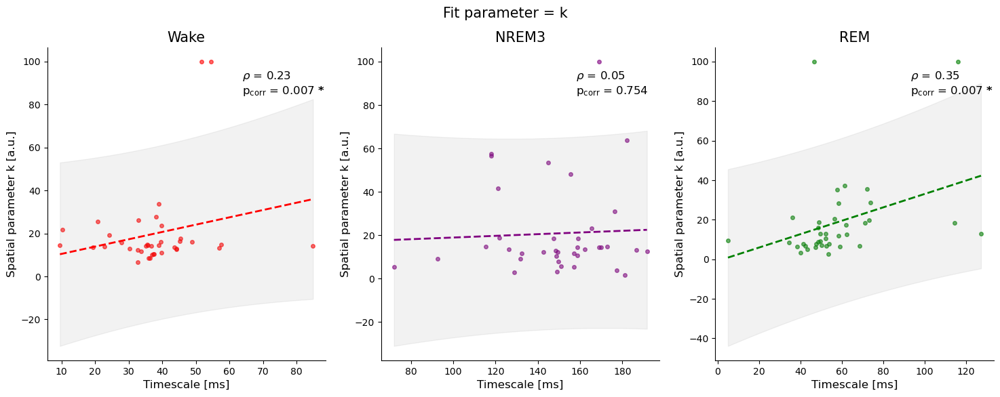

Stage: W, Param: a
Generating 1000 permutations...
Stage: N3, Param: a
Generating 1000 permutations...
Stage: R, Param: a
Generating 1000 permutations...


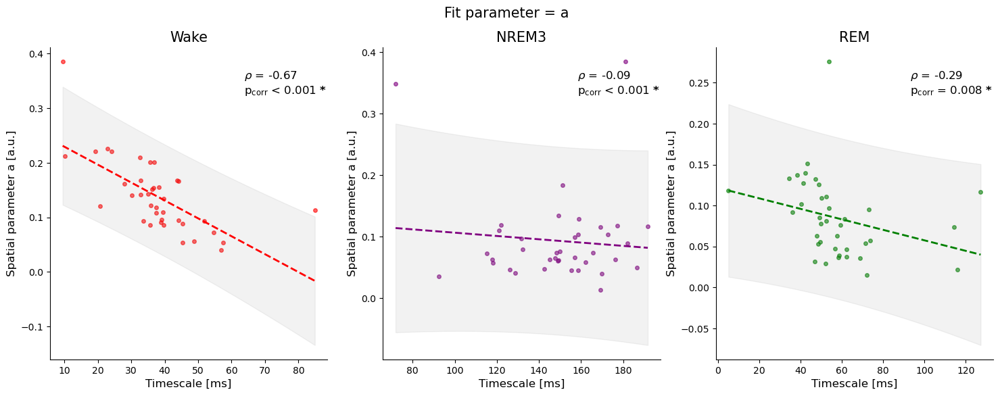

Stage: W, Param: b
Generating 1000 permutations...
Stage: N3, Param: b
Generating 1000 permutations...
Stage: R, Param: b
Generating 1000 permutations...


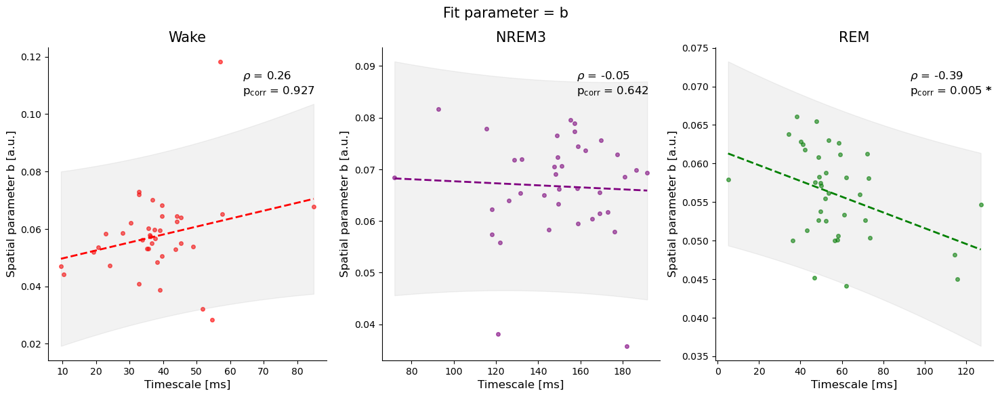

In [65]:
colors_stage = {"W": "r", "N3": "purple", "R": "g"}
title_dict = {"W": "Wake", "N3": "NREM3", "R": "REM"}


df_params_stages_corrc_all = {
    stage: pd.DataFrame(
        {k: v[stage] for k, v in params_stages_corrc_all.items()}
    ).T.rename(columns={0: "k", 1: "a", 2: "b"})
    for stage in ["W", "N3", "R"]
}

# Plot one figure per parameter
for param in ["k", "a", "b"]:

    # Define figure
    fig, axs = plt.subplots(1, 3, figsize=[18, 6])
    fig.suptitle(f"Fit parameter = {param}", fontsize=15)

    # One subplot per stage

    for i, stage in enumerate(["W", "N3", "R"]):
        print(f"Stage: {stage}, Param: {param}")

        # Get average tau per MNI region
        df_tau_stage_mni = uti.get_avg_tau_mni(df_tau[df_tau["stage"] == stage].copy())

        # Get spatial parameter
        df_spa = df_params_stages_corrc_all[stage][param]
        df_spa = df_spa.loc[df_tau_stage_mni.index]

        # Get correlation values
        rho, p_corr = uti.get_pcorr_mnia(
            df_tau_stage_mni, df_spa, map_coords, method="vasa", corr_type="pearson"
        )

        # Plot
        axs[i] = plot_corr(
            axs[i],
            df_tau_stage_mni.to_numpy().squeeze(),
            df_spa.to_numpy().squeeze(),
            rho,
            p_corr,
            color=colors_stage[stage],
            title=title_dict[stage],
            xlabel="Timescale [ms]",
            ylabel=f"Spatial parameter {param} [a.u.]",
        )

    plt.show()

Stage: W, Param: k
Generating 1000 permutations...
Stage: N3, Param: k
Generating 1000 permutations...
Stage: R, Param: k
Generating 1000 permutations...


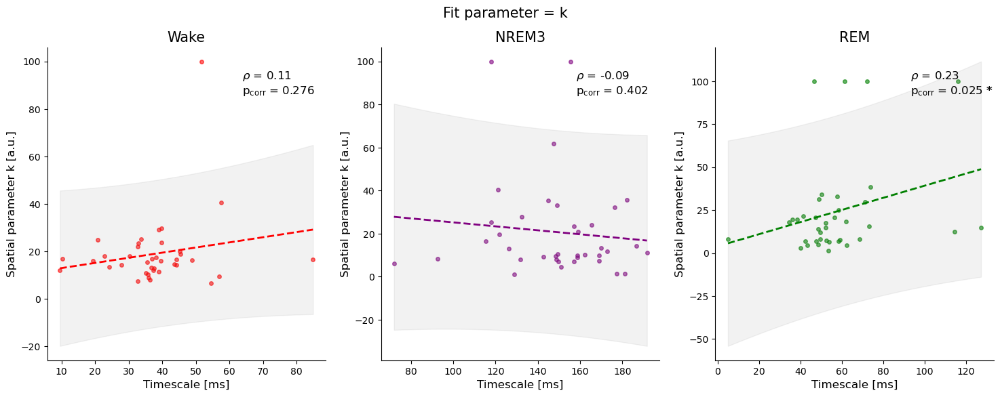

Stage: W, Param: a
Generating 1000 permutations...
Stage: N3, Param: a
Generating 1000 permutations...
Stage: R, Param: a
Generating 1000 permutations...


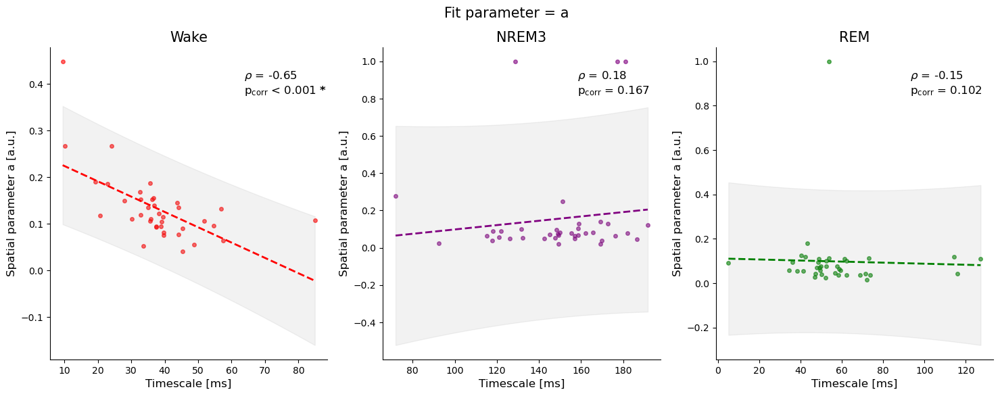

Stage: W, Param: b
Generating 1000 permutations...
Stage: N3, Param: b
Generating 1000 permutations...
Stage: R, Param: b
Generating 1000 permutations...


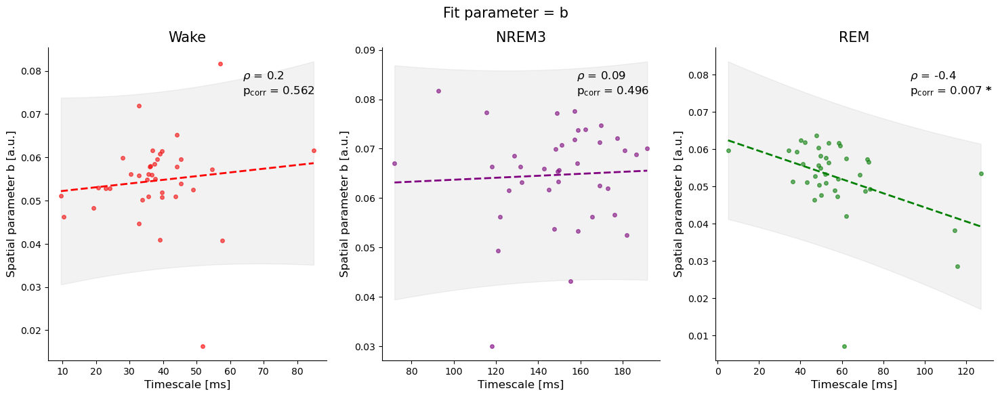

In [64]:
colors_stage = {"W": "r", "N3": "purple", "R": "g"}
title_dict = {"W": "Wake", "N3": "NREM3", "R": "REM"}


df_params_stages_corrc_bins = {
    stage: pd.DataFrame(
        {k: v[stage] for k, v in params_stages_corrc_bins.items()}
    ).T.rename(columns={0: "k", 1: "a", 2: "b"})
    for stage in ["W", "N3", "R"]
}

# Plot one figure per parameter
for param in ["k", "a", "b"]:

    # Define figure
    fig, axs = plt.subplots(1, 3, figsize=[18, 6])
    fig.suptitle(f"Fit parameter = {param}", fontsize=15)

    # One subplot per stage

    for i, stage in enumerate(["W", "N3", "R"]):
        print(f"Stage: {stage}, Param: {param}")

        # Get average tau per MNI region
        df_tau_stage_mni = uti.get_avg_tau_mni(df_tau[df_tau["stage"] == stage].copy())

        # Get spatial parameter
        df_spa = df_params_stages_corrc_bins[stage][param]
        df_spa = df_spa.loc[df_tau_stage_mni.index]

        # Get correlation values
        rho, p_corr = uti.get_pcorr_mnia(
            df_tau_stage_mni, df_spa, map_coords, method="vasa", corr_type="spearman"
        )

        # Plot
        axs[i] = plot_corr(
            axs[i],
            df_tau_stage_mni.to_numpy().squeeze(),
            df_spa.to_numpy().squeeze(),
            rho,
            p_corr,
            color=colors_stage[stage],
            title=title_dict[stage],
            xlabel="Timescale [ms]",
            ylabel=f"Spatial parameter {param} [a.u.]",
        )

    plt.show()